# Import

In [1]:
%load_ext autoreload
%autoreload 2

import scanpy as sc

import matplotlib.pyplot as plt
import time
import numpy as np
import pandas as pd


import warnings
warnings.simplefilter(action='ignore', category=Warning)
import os, sys
# to avoid any possible jupyter crashes due to rpy2 not finding the R install on conda
os.environ['R_HOME'] = sys.exec_prefix+"/lib/R/"
import scanpy as sc

import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
sc.set_figure_params(dpi=200,figsize=(6,4),fontsize=10,frameon=False)

## Invariant data representation

In [4]:
data_dir = '/lustre/scratch126/cellgen/team292/ha10/data/Fetal_Lung/'
adata = sc.read(data_dir+'adata_fatal_lung_whole_30_0_stage_study_nocg_nocc.h5ad')

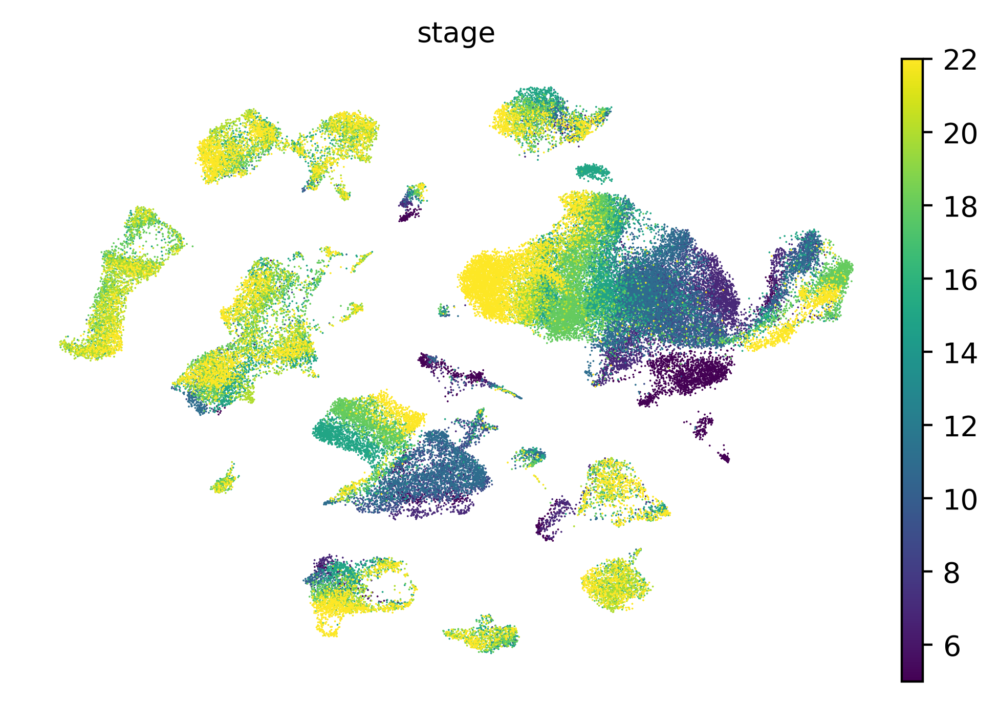

In [24]:
sc.pl.umap(adata,color='stage',palette="vlag")

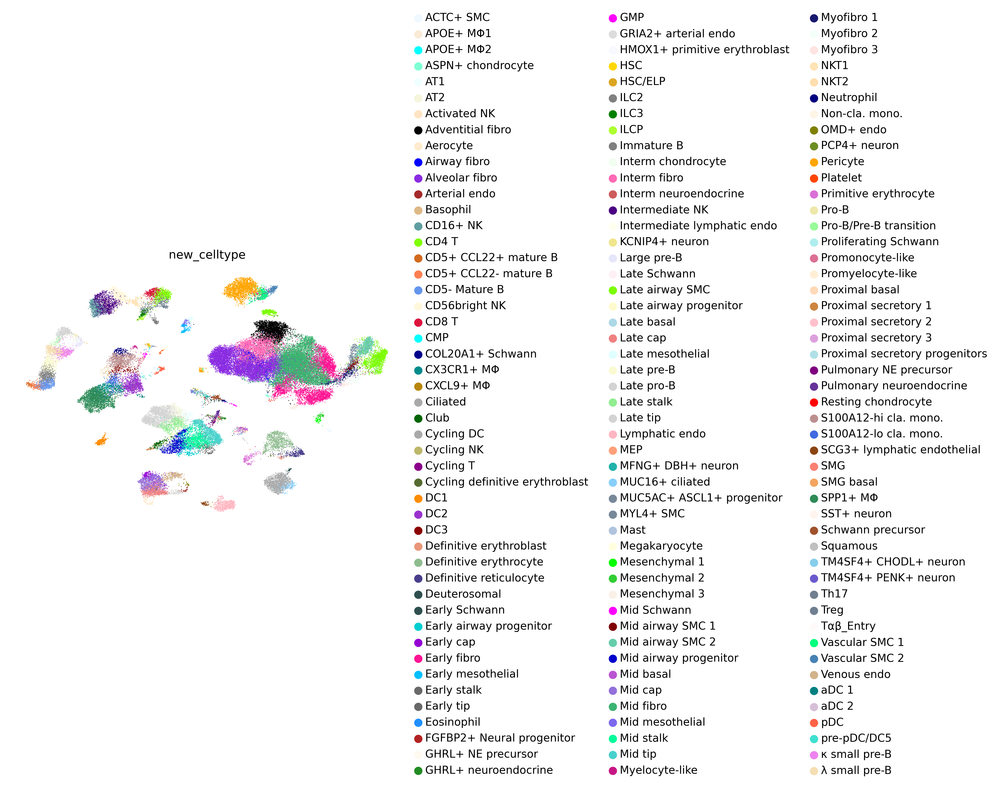

In [25]:
import matplotlib
sc.pl.umap(adata,color='new_celltype',palette=list(matplotlib.colors.CSS4_COLORS.values()))

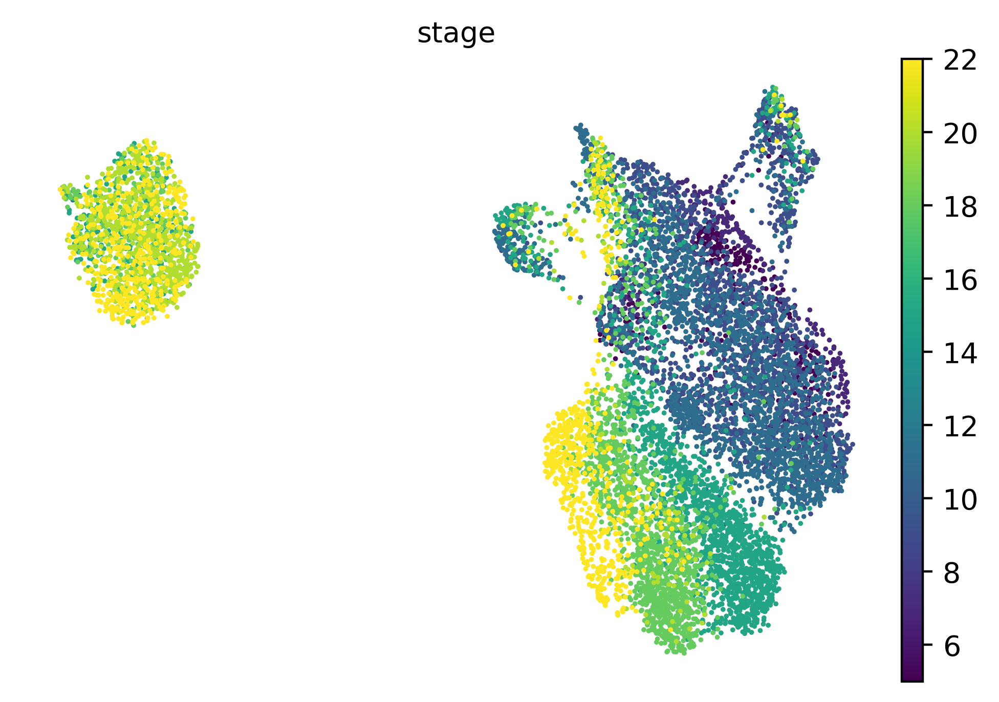

/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


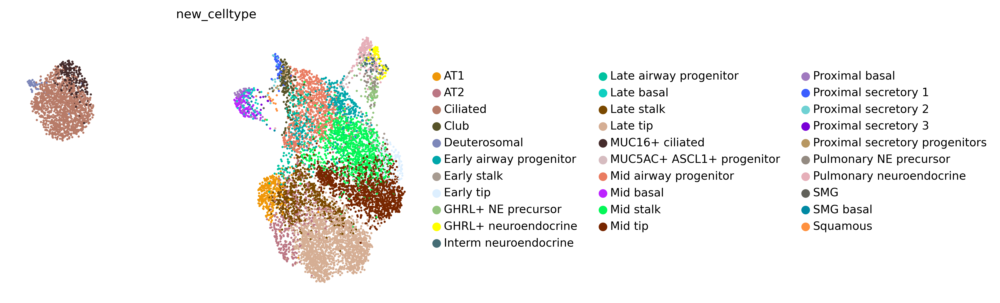

/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


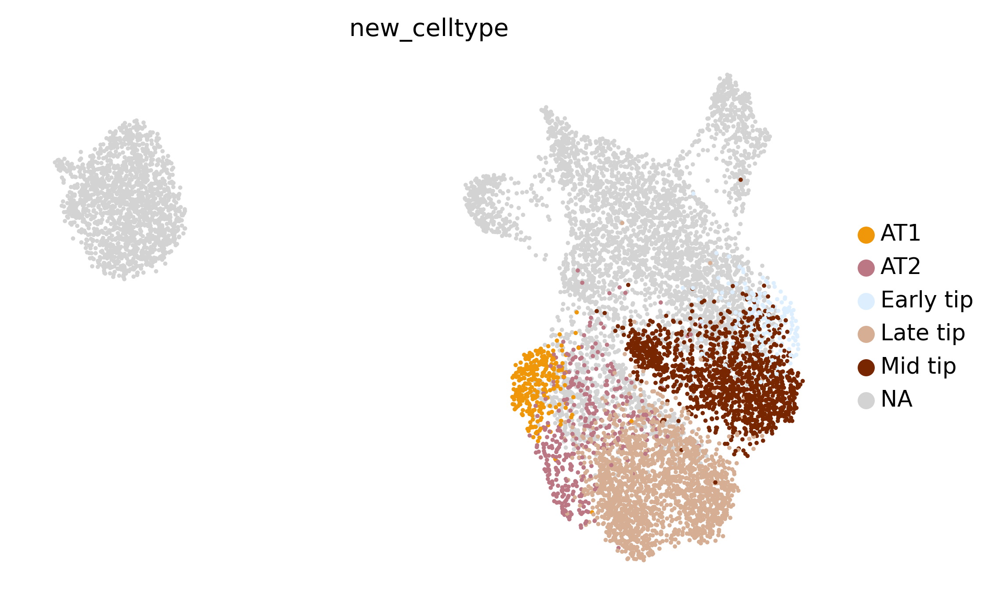

/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


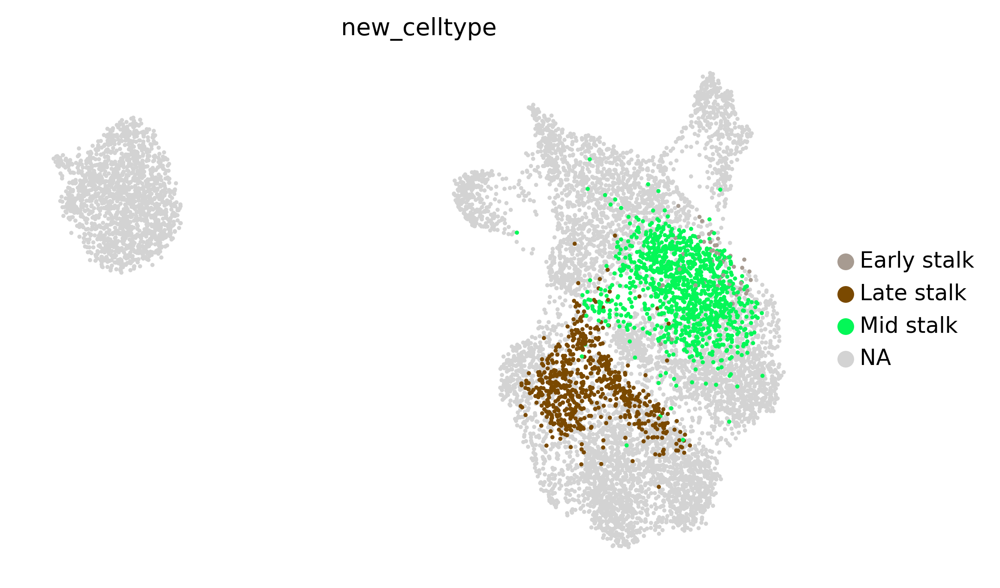

/nfs/team292/ha10/miniconda3/envs/data-an/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


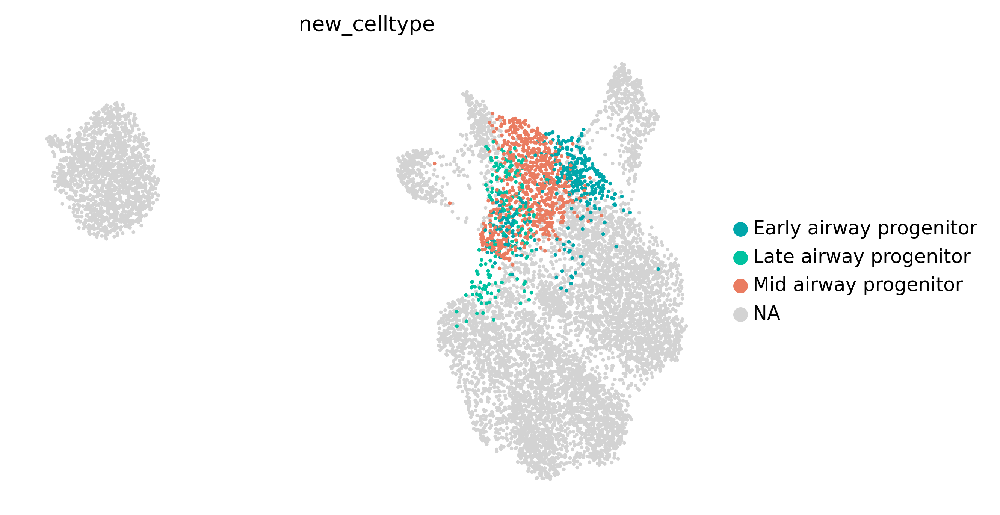

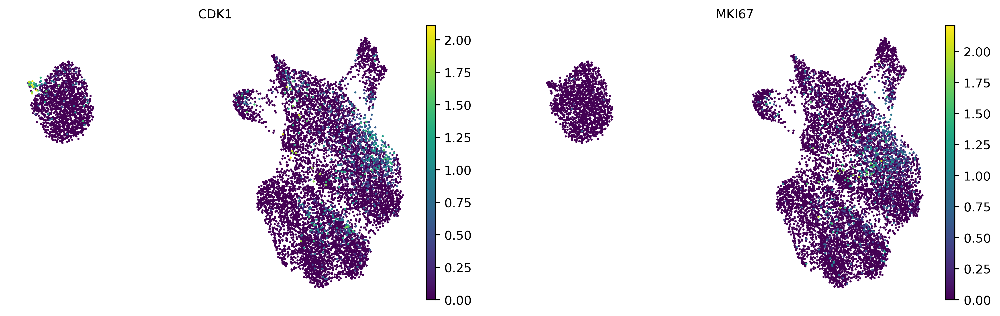

In [33]:
import matplotlib
import seaborn
adata_tmp = adata[adata.obs.broad_celltype.isin(['Distal epithelial','Proximal epithelial'])]
sc.pp.neighbors(adata_tmp, use_rep='X_FinVAE_30_0_nocg_nocc',n_neighbors=100)
sc.tl.umap(adata_tmp)
sc.pl.umap(adata_tmp,color='stage',palette="vlag")
adata_tmp.uns['new_celltype_colors'] = adata[adata_tmp.obs_names].uns['new_celltype_colors']
adata_tmp.write(data_dir+'adata_fetal_lung_epithelial_30_0_stage_study_nocg_nocc.h5ad')
sc.pl.umap(adata_tmp,color='new_celltype')
sc.pl.umap(adata_tmp,color='new_celltype',groups=['AT1','AT2','Early tip','Mid tip','Late tip'])
sc.pl.umap(adata_tmp,color='new_celltype',groups=['Early stalk','Mid stalk','Late stalk'])
sc.pl.umap(adata_tmp,color='new_celltype',groups=['Early airway progenitor','Mid airway progenitor','Late airway progenitor'])

sc.pl.umap(adata_tmp,color=['CDK1','MKI67'])

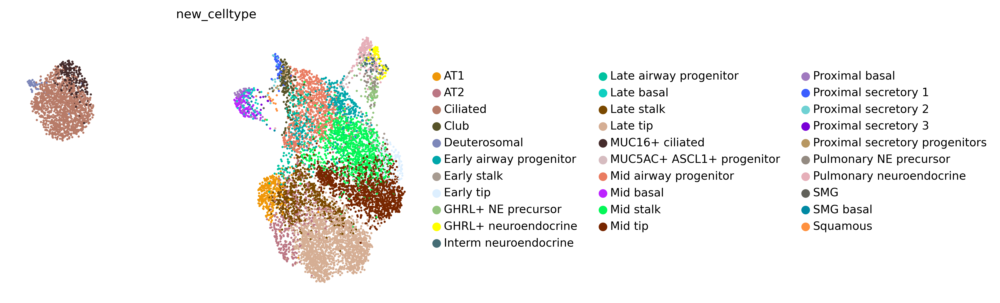

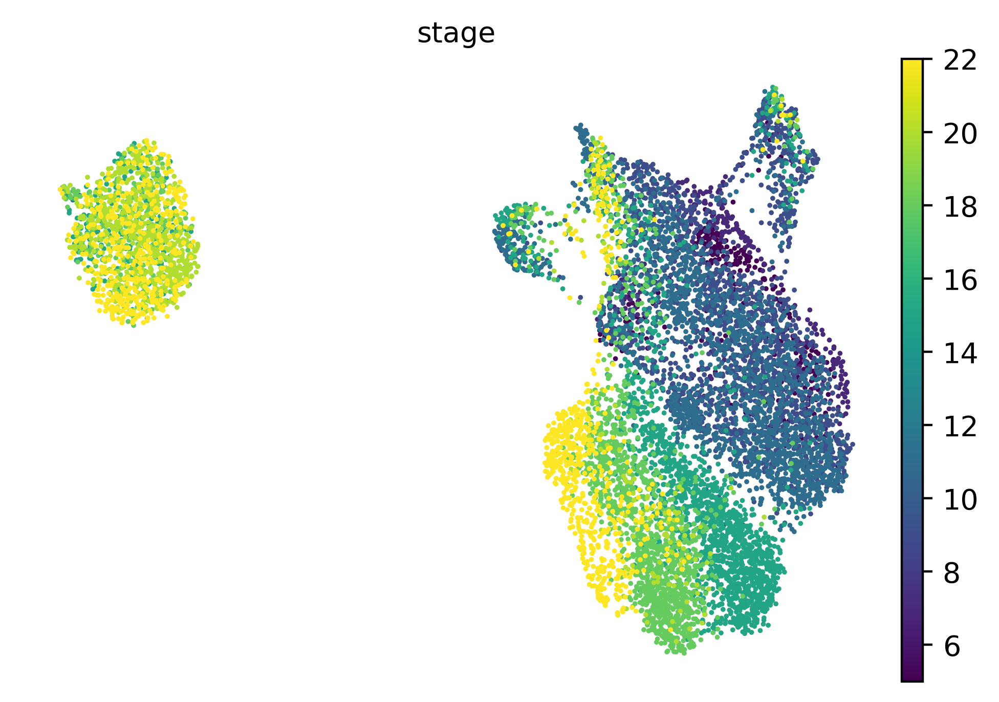

In [7]:
# data_dir = '/lustre/scratch126/cellgen/team292/ha10/data/Fetal_Lung/'
# adata_tmp = sc.read(data_dir+'adata_fetal_lung_epithelial_30_0_stage_study_nocg_nocc.h5ad')
# sc.pl.umap(adata_tmp,color='new_celltype')
# sc.pl.umap(adata_tmp,color='stage',palette="rocket")

## PAGA (neuroendocrine) 

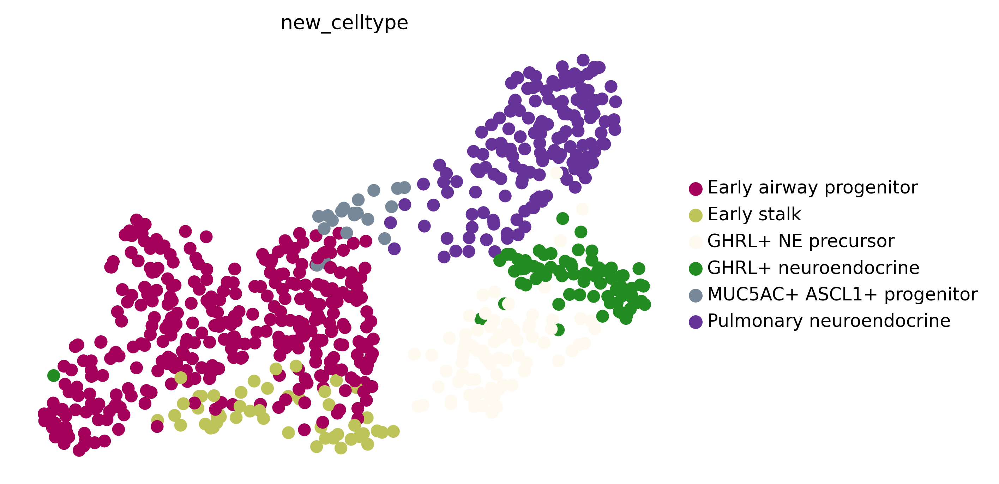

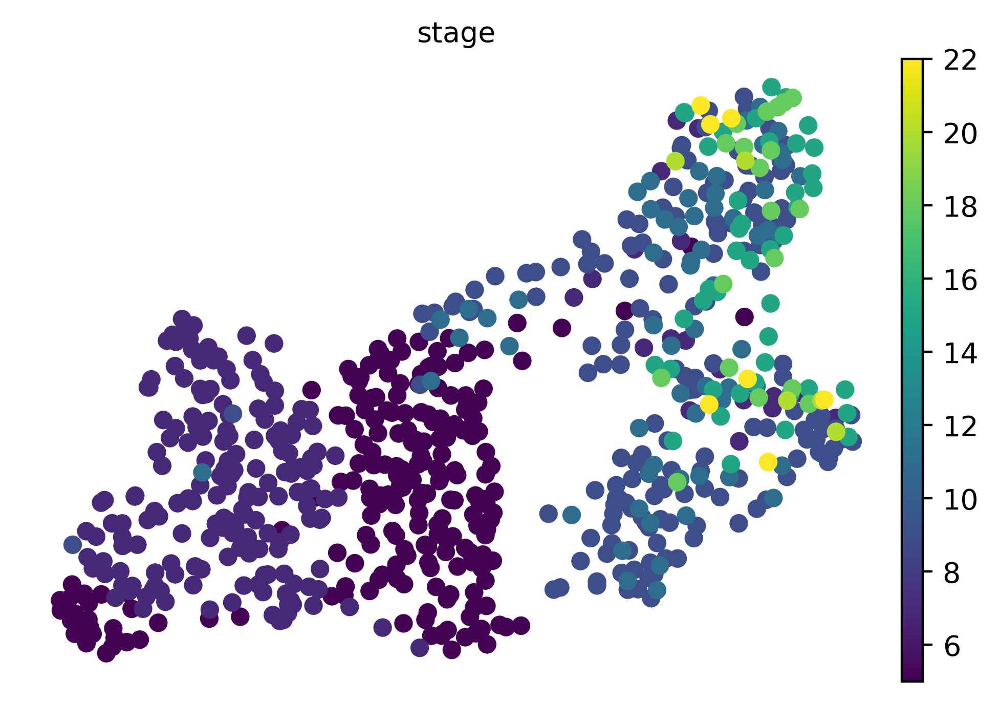

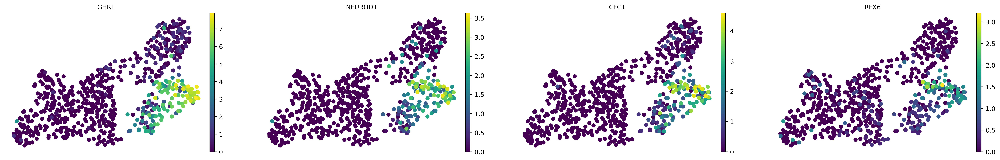

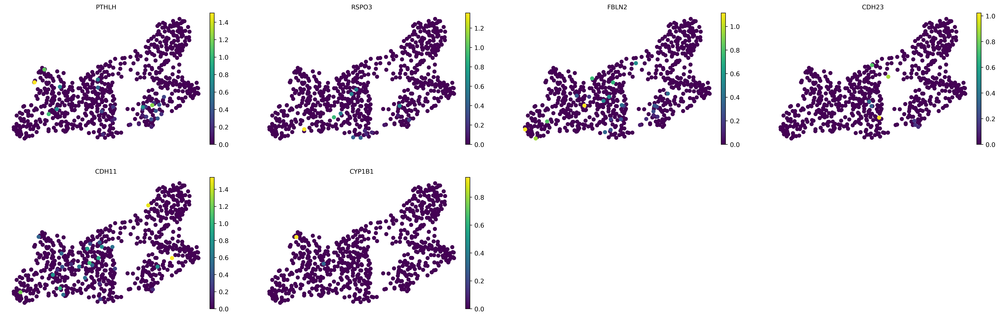

In [6]:
adata_tmp2 = adata_tmp[adata_tmp.obs.new_celltype.isin(['Pulmonary neuroendocrine','Early stalk','Early airway progenitor'
                                                       ,'GHRL+ neuroendocrine','GHRL+ NE precursor','MUC5AC+ ASCL1+ progenitor'])]
adata_tmp2 = adata_tmp2[adata_tmp2.obs.n_counts>2000]
sc.pp.neighbors(adata_tmp2, use_rep='X_FinVAE_30_0_nocg_nocc',n_neighbors=70)
sc.tl.umap(adata_tmp2)
sc.pl.umap(adata_tmp2,color='new_celltype')
sc.pl.umap(adata_tmp2,color='stage')
sc.pl.umap(adata_tmp2,color=['GHRL', 'NEUROD1', 'CFC1', 'RFX6'])
sc.pl.umap(adata_tmp2,color=['PTHLH', 'RSPO3', 'FBLN2', 'CDH23', 'CDH11', 'CYP1B1'])

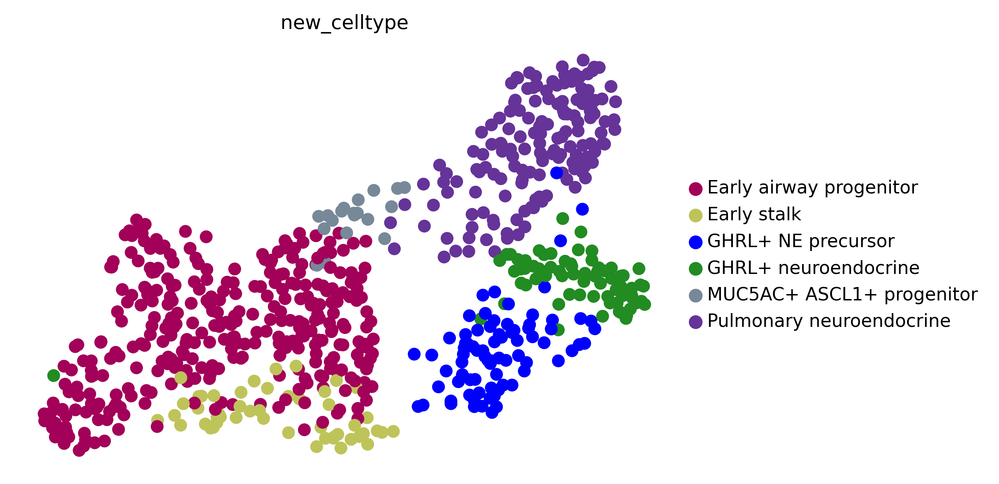

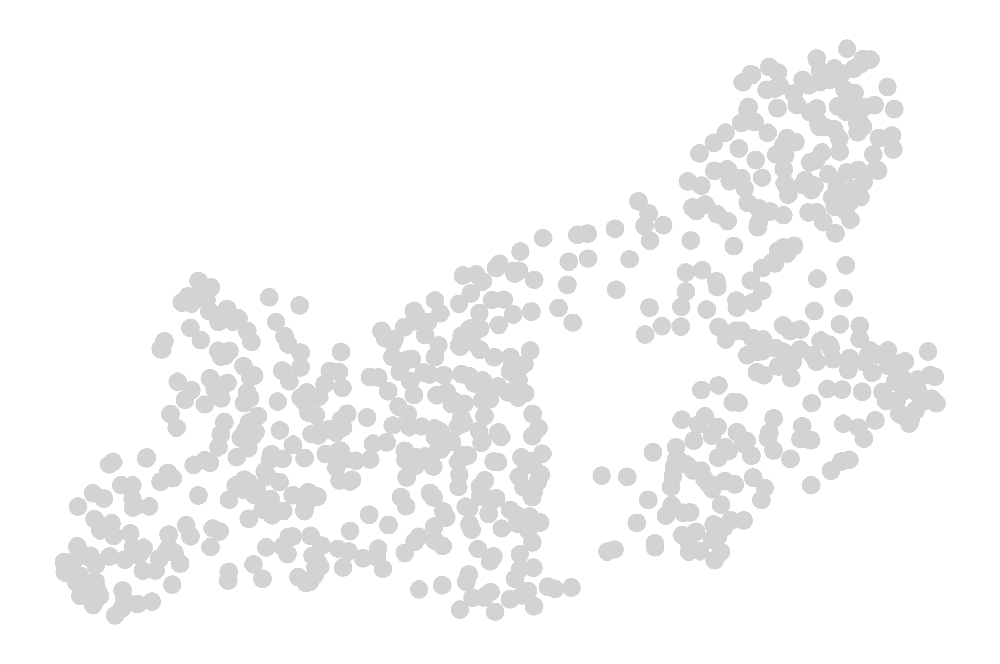

In [11]:
sc.pl.umap(adata_tmp2,color='new_celltype',palette=['#a30059', '#bec459', 'blue', '#228b22', '#778899', '#663399'],save='_neuroendocrine_celltype.pdf')
sc.pl.umap(adata_tmp2,save='_neuroendocrine_grey.pdf')

In [68]:
sc.tl.paga(adata_tmp2, groups='new_celltype')

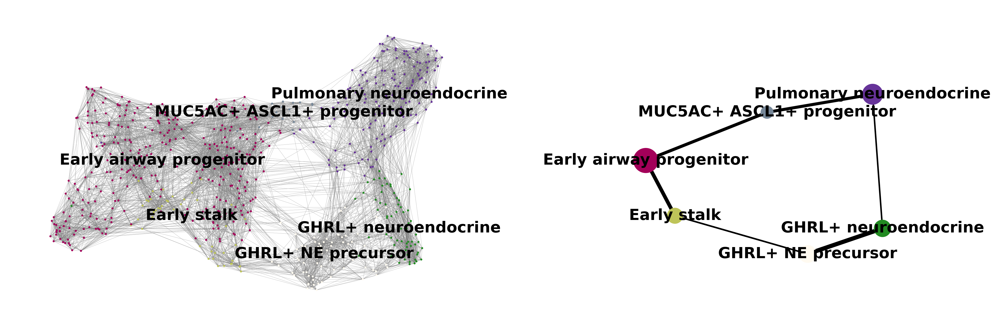

In [75]:
sc.tl.paga(adata_tmp2,groups='new_celltype')
sc.pl.paga_compare(
    adata_tmp2,
    threshold=0.3,
    title="",
    right_margin=0.02,
    size=10,
    edge_width_scale=0.5,
    legend_fontsize=12,
    fontsize=12,
    frameon=False,
    edges=True,
    save=True,
)

## Milo 

In [4]:
import milopy
import milopy.core as milo

In [5]:
from rpy2.robjects.packages import PackageNotInstalledError, importr
import rpy2.robjects.numpy2ri
from rpy2.robjects import pandas2ri
import rpy2.robjects as ro
from rpy2.robjects.conversion import localconverter
from rpy2.robjects.packages import STAP

def _try_import_bioc_library(name):
    try:
        _r_lib = importr(name)
        return _r_lib
    except PackageNotInstalledError:
        raise RuntimeError(
            f"Install Bioconductor library `{name!r}` first as `BiocManager::install({name!r}).`"
        )

In [6]:
import rpy2
rpy2.robjects.numpy2ri.activate()
rpy2.robjects.pandas2ri.activate()


edgeR = _try_import_bioc_library("edgeR")
limma = _try_import_bioc_library("limma")
stats = importr("stats")
base = importr("base")

In [7]:
importr("statmod")

rpy2.robjects.packages.Package as a <module 'statmod'>

In [8]:
data_dir = '/lustre/scratch126/cellgen/team292/ha10/data/Fetal_Lung/'
adata_tmp = sc.read(data_dir+'adata_fetal_lung_epithelial_30_0_stage_study_nocg_nocc.h5ad')

adata_tip = adata_tmp[adata_tmp.obs.new_celltype.isin(['AT1','AT2','Early tip','Mid tip','Late tip'])]
adata_stalk = adata_tmp[adata_tmp.obs.new_celltype.isin(['Early stalk','Mid stalk','Late stalk'])]
adata_airway = adata_tmp[adata_tmp.obs.new_celltype.isin(['Early airway progenitor','Mid airway progenitor','Late airway progenitor'])]

In [10]:
## Build KNN graph
sc.pp.neighbors(adata_tip, n_neighbors=10, use_rep="X_FinVAE_30_0_nocg_nocc")
sc.pp.neighbors(adata_stalk, n_neighbors=10, use_rep="X_FinVAE_30_0_nocg_nocc")
sc.pp.neighbors(adata_airway, n_neighbors=10, use_rep="X_FinVAE_30_0_nocg_nocc")

## Assign cells to neighbourhoods
milo.make_nhoods(adata_tip)
milo.make_nhoods(adata_stalk)
milo.make_nhoods(adata_airway)

## Count cells from each sample in each nhood
milo.count_nhoods(adata_tip, sample_col="study")
milo.count_nhoods(adata_stalk, sample_col="study")
milo.count_nhoods(adata_airway, sample_col="study")

In [11]:
%load_ext rpy2.ipython

In [12]:
milopy.utils.build_nhood_graph(adata_tip)
milopy.utils.build_nhood_graph(adata_stalk)
milopy.utils.build_nhood_graph(adata_airway)

In [13]:
milopy.utils.annotate_nhoods_continuous(adata_tip, 'stage')
milopy.utils.annotate_nhoods_continuous(adata_stalk, 'stage')
milopy.utils.annotate_nhoods_continuous(adata_airway, 'stage')

milopy.utils.annotate_nhoods(adata_tip, 'new_celltype')
milopy.utils.annotate_nhoods(adata_stalk, 'new_celltype')
milopy.utils.annotate_nhoods(adata_airway, 'new_celltype')

In [14]:
adata_tip.obs.stage = adata_tip.obs.stage.astype(str)
sc.tl.rank_genes_groups(adata_tip,groupby ='stage',method='wilcoxon')
# sc.pl.rank_genes_groups(adata_tip)

result = adata_tip.uns["rank_genes_groups"]
groups = result["names"].dtype.names
DEs = pd.DataFrame(
    {
        group + "_" + key[:1]: result[key][group]
        for group in groups
        for key in ["names", "pvals"]
    }
)
top_DEs_tip = []#list(DEs[:10].iloc[:,0])
for i in range(0,8):
    top_DEs_tip = top_DEs_tip + list(DEs[:5].iloc[:,i*2]) 

len(top_DEs_tip)


adata_stalk.obs.stage = adata_stalk.obs.stage.astype(str)
sc.tl.rank_genes_groups(adata_stalk,groupby ='stage',method='wilcoxon')
# sc.pl.rank_genes_groups(adata_stalk)

result = adata_stalk.uns["rank_genes_groups"]
groups = result["names"].dtype.names
DEs = pd.DataFrame(
    {
        group + "_" + key[:1]: result[key][group]
        for group in groups
        for key in ["names", "pvals"]
    }
)
top_DEs_stalk = []#list(DEs[:10].iloc[:,0])
for i in range(0,8):
    top_DEs_stalk = top_DEs_stalk + list(DEs[:5].iloc[:,i*2]) 

len(top_DEs_stalk)



adata_airway.obs.stage = adata_airway.obs.stage.astype(str)
sc.tl.rank_genes_groups(adata_airway,groupby ='stage',method='wilcoxon')
# sc.pl.rank_genes_groups(adata_airway)

result = adata_airway.uns["rank_genes_groups"]
groups = result["names"].dtype.names
DEs = pd.DataFrame(
    {
        group + "_" + key[:1]: result[key][group]
        for group in groups
        for key in ["names", "pvals"]
    }
)
top_DEs_airway = []#list(DEs[:10].iloc[:,0])
for i in range(0,8):
    top_DEs_airway = top_DEs_airway + list(DEs[:5].iloc[:,i*2]) 

len(top_DEs_airway)

40

In [15]:

for gene in top_DEs_tip:
    # print(gene)
    adata_tip.obs[gene] = adata_tip.raw.to_adata()[:,gene].X.todense().flatten().tolist()[0]
    milopy.utils.annotate_nhoods_continuous(adata_tip, gene)
    
for gene in top_DEs_stalk:
    adata_stalk.obs[gene] = adata_stalk.raw.to_adata()[:,gene].X.todense().flatten().tolist()[0]
    milopy.utils.annotate_nhoods_continuous(adata_stalk, gene)
    
for gene in top_DEs_airway:
    adata_airway.obs[gene] = adata_airway.raw.to_adata()[:,gene].X.todense().flatten().tolist()[0]
    milopy.utils.annotate_nhoods_continuous(adata_airway, gene)

In [16]:
import scanpy as sc
import pandas as pd
import numpy as np
import anndata
from typing import Union, Optional, Sequence, Any, Mapping, List, Tuple
from anndata import AnnData

import matplotlib.pyplot as plt
import seaborn as sns


def plot_nhood_graph(
    adata: AnnData,
    alpha: float = 0.1,
    min_logFC: float = 0,
    min_size: int = 10,
    plot_edges: bool = False,
    color: str = 'logFC',
    title: str = "DA log-Fold Change",
    **kwargs
):
    '''
    Visualize DA results on abstracted graph (wrapper around sc.pl.embedding)

    Params:
    -------
    - adata: AnnData object
    - alpha: significance threshold
    - min_logFC: minimum absolute log-Fold Change to show results (default: 0, show all significant neighbourhoods)
    - min_size: minimum size of nodes in visualization (default: 10)
    - plot_edges: boolean indicating if edges for neighbourhood overlaps whould be plotted (default: False)
    - title: plot title (default: 'DA log-Fold Change')
    - **kwargs: other arguments to pass to scanpy.pl.embedding
    '''
    nhood_adata = adata.uns["nhood_adata"].copy()

    if "Nhood_size" not in nhood_adata.obs.columns:
        raise KeyError(
            'Cannot find "Nhood_size" column in adata.uns["nhood_adata"].obs -- \
                please run milopy.utils.build_nhood_graph(adata)'
        )

    nhood_adata.obs["graph_color"] = nhood_adata.obs[color]
    # nhood_adata.obs.loc[nhood_adata.obs["SpatialFDR"]
    #                     > alpha, "graph_color"] = np.nan
    nhood_adata.obs["abs_color"] = (nhood_adata.obs[color])
    # nhood_adata.obs.loc[nhood_adata.obs["abs_color"]
    #                     < min_logFC, "graph_color"] = np.nan

    # Plotting order - extreme logFC on top
    nhood_adata.obs.loc[nhood_adata.obs["graph_color"].isna(),
                        "abs_color"] = np.nan
    ordered = nhood_adata.obs.sort_values(
        'abs_color', na_position='first').index
    nhood_adata = nhood_adata[ordered]

    # vmax = np.max([nhood_adata.obs["graph_color"].max(),
    #               abs(nhood_adata.obs["graph_color"].min())])
    # vmin = - vmax

    sc.pl.embedding(nhood_adata, "X_milo_graph",
                    color="graph_color", cmap="rocket",
                    size=adata.uns["nhood_adata"].obs["Nhood_size"]*min_size,
                    edges=plot_edges, neighbors_key="nhood",
                    # edge_width =
                    sort_order=False,
                    frameon=False,
                    # vmax=vmax, vmin=vmin,
                    title=color,
                    **kwargs
                    )


def plot_nhood(adata, ix, basis="X_umap"):
    '''
    Visualize cells in a neighbourhood
    '''
    adata.obs["Nhood"] = adata.obsm["nhoods"][:, ix].toarray().ravel()
    sc.pl.embedding(adata, basis, color="Nhood",
                    size=30, title="Nhood" + str(ix))

# Plot nhood beeswarm


def plot_DA_beeswarm(
    adata: AnnData,
    anno_col: str = 'nhood_annotation',
    alpha: float = 0.1,
    subset_nhoods: List = None
):
    '''
    Plot beeswarm plot of logFC against nhood labels

    Params:
    -------
    - adata: AnnData object
    - anno_col: column in adata.uns['nhood_adata'].obs to use as annotation
    - alpha: significance threshold
    - subset_nhoods: list of nhoods to plot (default: None, plot all nhoods)
    '''
    try:
        nhood_adata = adata.uns["nhood_adata"].copy()
    except KeyError:
        raise KeyError(
            'Cannot find "nhood_adata" slot in adata.uns -- please run milopy.make_nhoods_adata(adata)'
        )

    if subset_nhoods is not None:
        nhood_adata = nhood_adata[subset_nhoods]

    try:
        nhood_adata.obs[anno_col]
    except KeyError:
        raise KeyError(
            'Cannot find {a} in adata.uns["nhood_adata"].obs -- \
                please run milopy.utils.annotate_nhoods(adata, anno_col) first'.format(a=anno_col)
        )

    try:
        nhood_adata.obs["logFC"]
    except KeyError:
        raise KeyError(
            'Cannot find `logFC` in adata.uns["nhood_adata"].obs -- \
                please run milopy.core.DA_nhoods(adata) first'
        )

    sorted_annos = nhood_adata.obs[[anno_col, "logFC"]].\
        groupby(anno_col).\
        median().\
        sort_values("logFC", ascending=True).index

    anno_df = nhood_adata.obs[[anno_col, "logFC", "SpatialFDR"]].copy()
    anno_df['is_signif'] = anno_df['SpatialFDR'] < alpha
    # anno_df['across_organs'] = ["Significant across organs" if x else "" for x in (keep_nhoods & signif_nhoods)]
    anno_df = anno_df[anno_df[anno_col] != "nan"]

    try:
        anno_palette = _get_palette_adata(
            adata, nhood_adata.uns['annotation_obs'])
        sns.violinplot(data=anno_df, y=anno_col, x="logFC", order=sorted_annos,
                       size=190, inner=None, orient="h",
                       palette=anno_palette,
                       linewidth=0,
                       scale="width")
    except:
        sns.violinplot(data=anno_df, y=anno_col, x="logFC", order=sorted_annos,
                       size=190, inner=None, orient="h",
                       linewidth=0,
                       scale="width")
    sns.stripplot(data=anno_df, y=anno_col, x="logFC", order=sorted_annos, size=2,
                  hue='is_signif', palette=['grey', 'black'],
                  orient="h", alpha=0.5)
    plt.legend(loc='upper left', title=f'< {int(alpha*100)}% SpatialFDR',
               bbox_to_anchor=(1, 1), frameon=False)
    plt.axvline(x=0, ymin=0, ymax=1, color="black", linestyle="--")


def _get_palette_adata(adata, obs_col):
    return(dict(zip(adata.obs[obs_col].cat.categories, adata.uns[f'{obs_col}_colors'])))


### Plot boxplot of cell numbers for QC ###
def plot_nhood_counts_by_cond(
        adata: AnnData,
        test_var: str,
        subset_nhoods: List = None,
        log_counts: bool = False):
    '''
    Plot boxplot of cell numbers vs condition of interest

    Params:
    ------
    - adata: anndata object storing neighbourhood information in adata.uns
    - test_var: string, name of column in adata.obs storing condition of interest (y-axis for boxplot)
    - subset_nhoods: list of obs_names for neighbourhoods to include in plot (default: None, plot all nhoods)
    - log_counts: boolean, whether to plot log1p of cell counts (default: False)
    '''
    try:
        nhood_adata = adata.uns["nhood_adata"].copy()
    except KeyError:
        raise KeyError(
            'Cannot find "nhood_adata" slot in adata.uns -- please run milopy.make_nhoods_adata(adata)'
        )

    if subset_nhoods is None:
        subset_nhoods = nhood_adata.obs_names

    pl_df = pd.DataFrame(nhood_adata[subset_nhoods].X.A, columns=nhood_adata.var_names).melt(
        var_name=nhood_adata.uns['sample_col'], value_name='n_cells')
    pl_df = pd.merge(pl_df, nhood_adata.var)
    pl_df['log_n_cells'] = np.log1p(pl_df['n_cells'])
    if not log_counts:
        sns.boxplot(data=pl_df, x=test_var, y='n_cells', color='lightblue')
        sns.stripplot(data=pl_df, x=test_var, y='n_cells', color='black', s=3)
        plt.ylabel('# cells')
    else:
        sns.boxplot(data=pl_df, x=test_var, y='log_n_cells', color='lightblue')
        sns.stripplot(data=pl_df, x=test_var,
                      y='log_n_cells', color='black', s=3)
        plt.ylabel('log(# cells + 1)')

    plt.xticks(rotation=90)
    plt.xlabel(test_var)

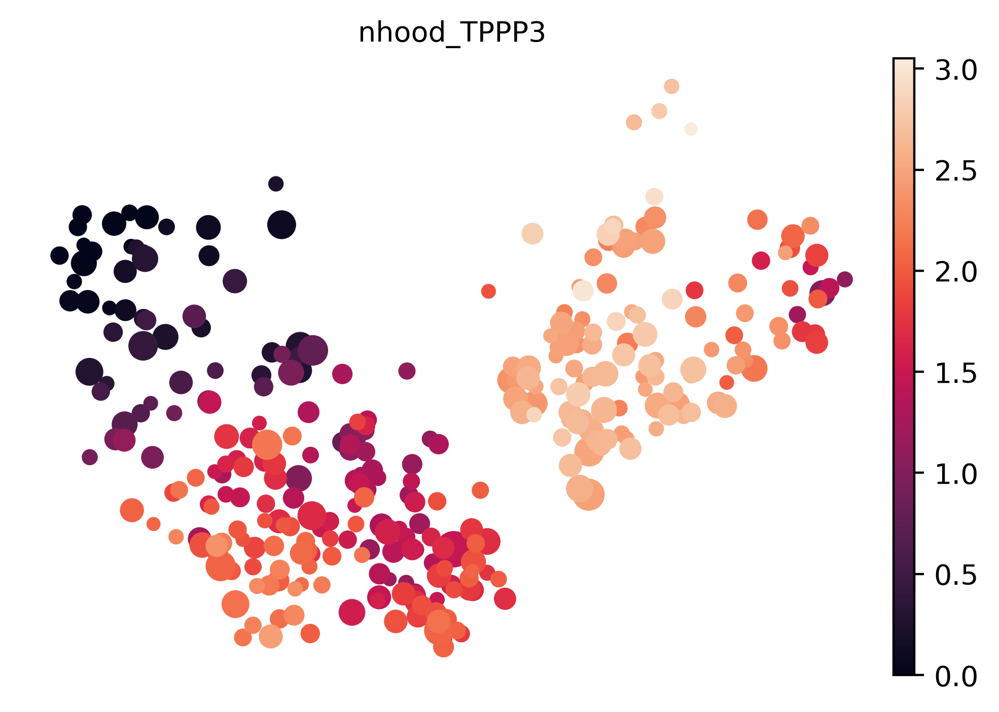

In [18]:
plot_nhood_graph(adata_tip, alpha=0.2, min_size=10,color='nhood_TPPP3',save='_lung_atlas_milo_TPPP3.pdf')

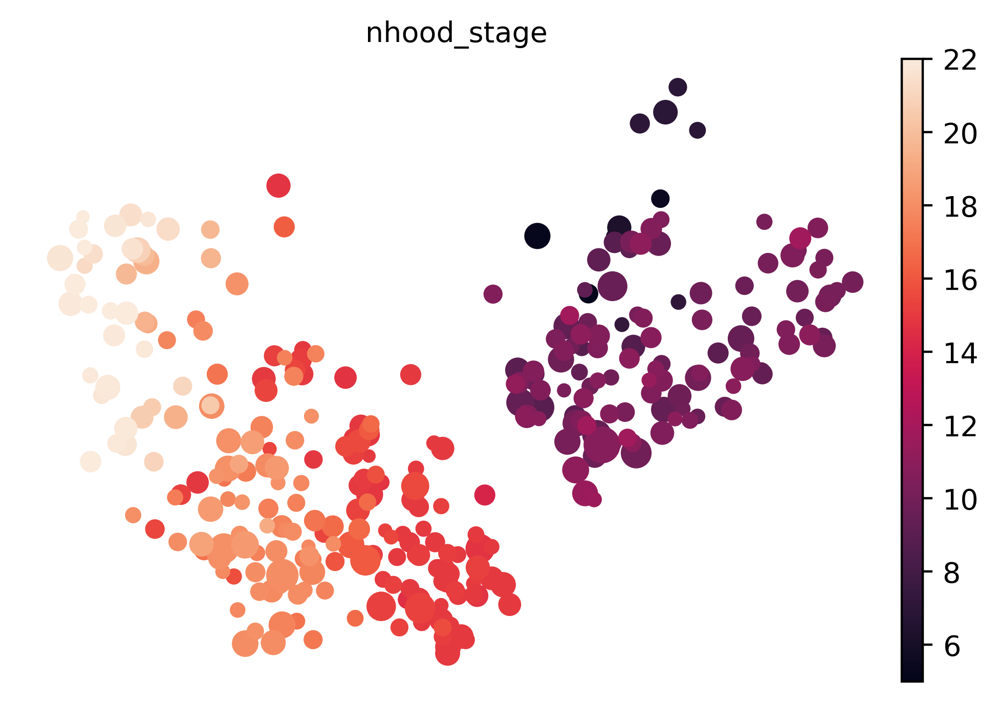

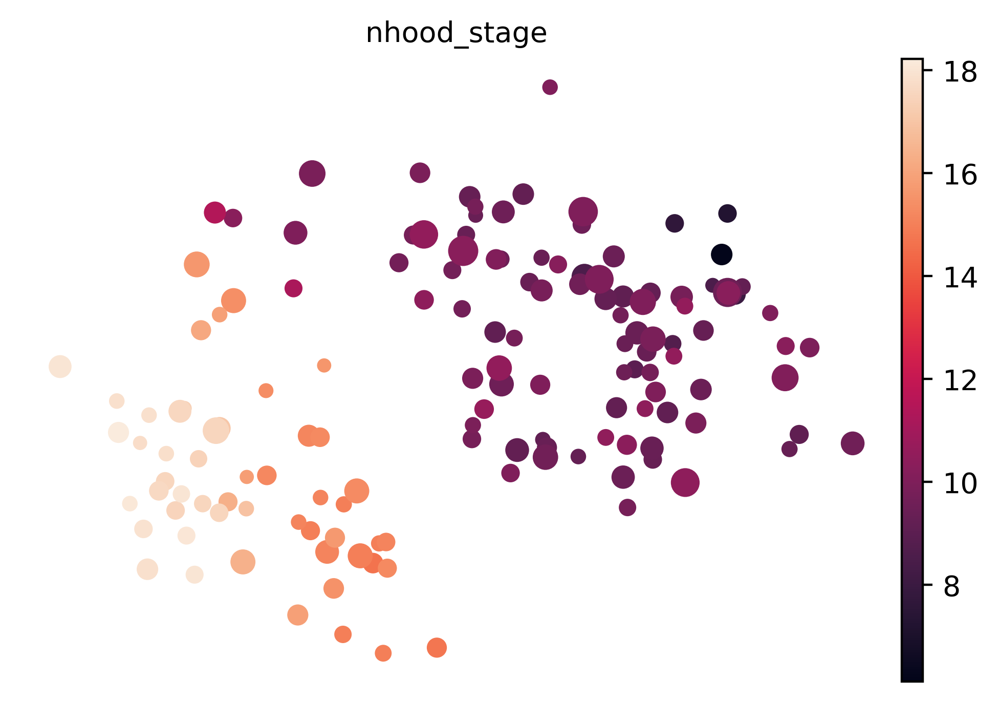

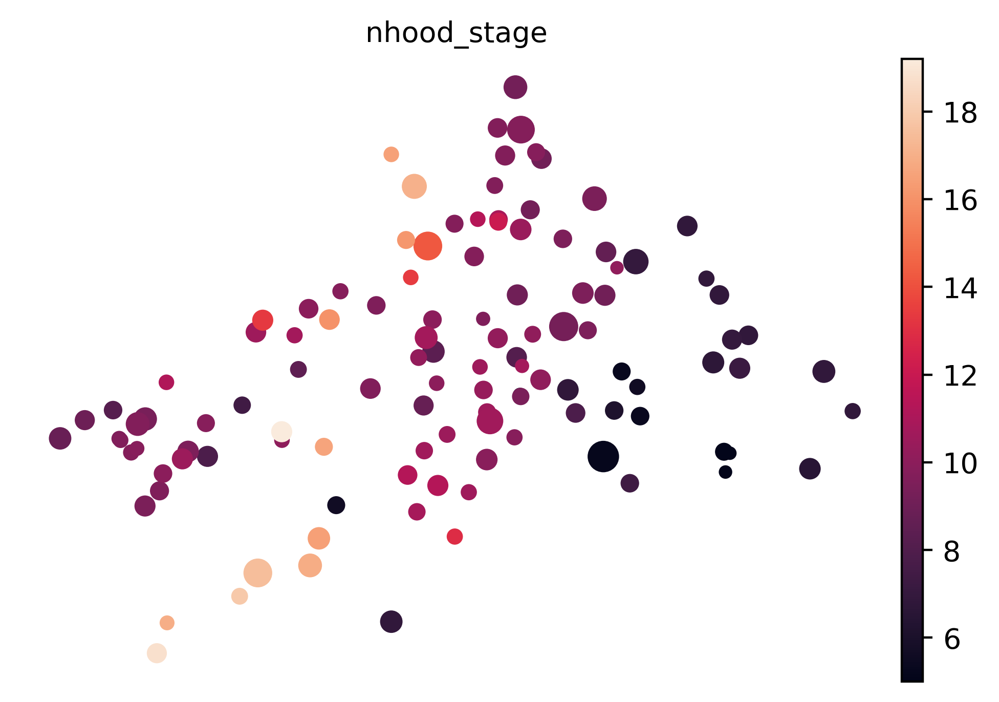

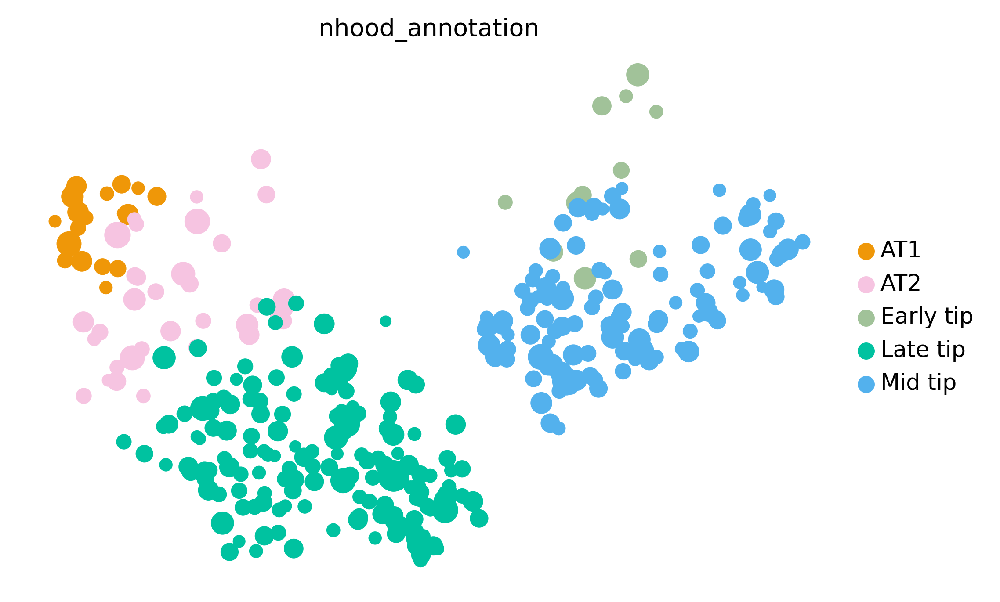

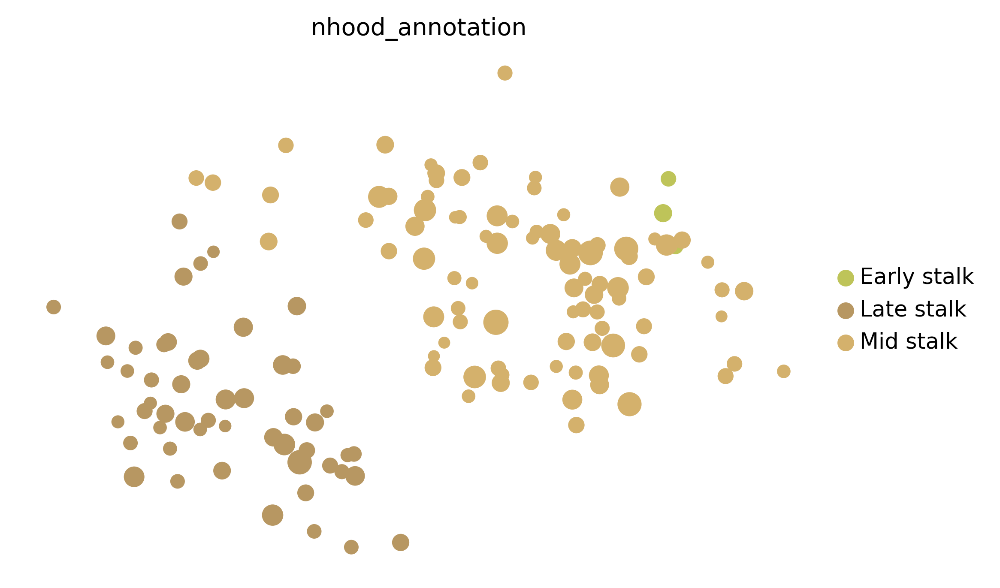

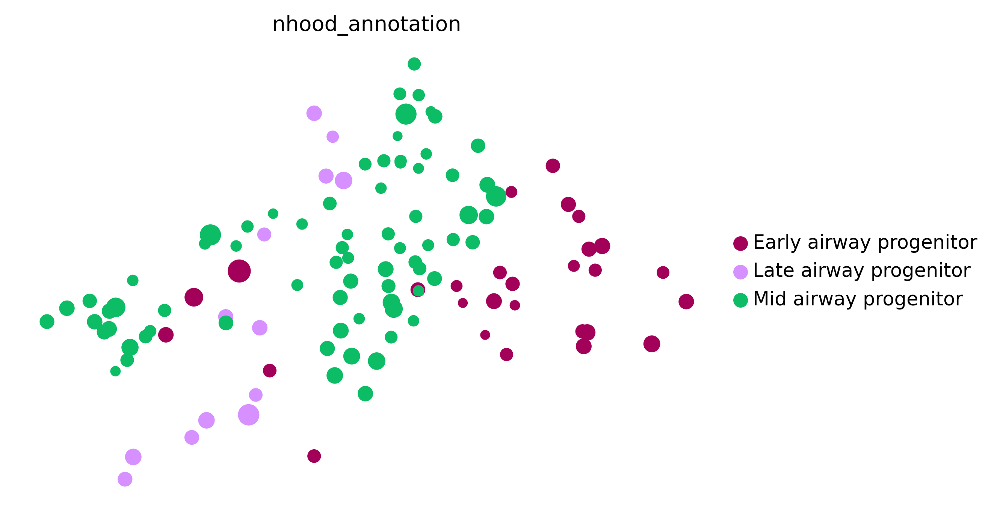

In [17]:
plot_nhood_graph(adata_tip, alpha=0.2, min_size=10,color='nhood_stage',save='_lung_atlas_milo_nhood_stage_tip.pdf')
plot_nhood_graph(adata_stalk, alpha=0.2, min_size=10,color='nhood_stage',save='_lung_atlas_milo_nhood_stage_stalk.pdf')
plot_nhood_graph(adata_airway, alpha=0.2, min_size=10,color='nhood_stage',save='_lung_atlas_milo_nhood_stage_airway.pdf')

colors_dict = {'Mid tip': '#53b1ed',
 'Late tip': '#00c2a0',
 'AT2': '#f6c4e1',
 'AT1': '#ef9708',
 'Early tip': '#a1c299'}
plot_nhood_graph(adata_tip, alpha=0.2, min_size=10,color='nhood_annotation',save='_lung_atlas_milo_nhood_ann_tip.pdf',palette=colors_dict)
colors_dict = {'Early stalk': '#bec459',
 'Mid stalk': '#d4b16c',
 'Late stalk': '#b79762'}
plot_nhood_graph(adata_stalk, alpha=0.2, min_size=10,color='nhood_annotation',save='_lung_atlas_milo_nhood_ann_stalk.pdf',palette=colors_dict)
colors_dict = {'Mid airway progenitor': '#0cbd66',
 'Late airway progenitor': '#d790ff',
 'Early airway progenitor': '#a30059'}
plot_nhood_graph(adata_airway, alpha=0.2, min_size=10,color='nhood_annotation',save='_lung_atlas_milo_nhood_ann_airway.pdf',palette=colors_dict)

In [20]:
nhood_adata_tip = adata_tip.uns["nhood_adata"]
nhood_adata_stalk = adata_stalk.uns["nhood_adata"]
nhood_adata_airway = adata_airway.uns["nhood_adata"]

In [99]:
nhood_adata_tip.write(data_dir+'nhood_adata_tip.h5ad')
nhood_adata_stalk.write(data_dir+'nhood_adata_stalk.h5ad')
nhood_adata_airway.write(data_dir+'nhood_adata_airway.h5ad')

In [21]:
# compute roc functions
from sklearn.metrics import roc_auc_score
def compute_roc(data,y,cell_type_column):
    roc = roc_auc_score(
        y_score=data[y].values,
        y_true=data[cell_type_column].values,
        labels=data[cell_type_column].unique(),
    )

    if roc < 0.5:
        roc = 1 - roc
    return roc

def compute_mean_roc(data,y,cell_type_column):
    from itertools import combinations

    combos = list(combinations(data[cell_type_column].unique(), 2))
    roc = np.mean(
        [
            compute_roc(data.loc[data[cell_type_column].isin(combo)],y,cell_type_column)
            for combo in combos
        ]
    )
    return roc

In [22]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
from scipy.stats import linregress
from itertools import combinations
from sklearn.metrics import silhouette_score

# silh = sklearn.metrics.silhouette_score(
#     X=sns_df["Normalized accessibility"].values.reshape(-1, 1),
#     labels=sns_df["Cell type"].values,
# )
# roc = compute_mean_roc(sns_df)

def plot_density_with_distribution(data, x, y, cell_type_column, gene, colors_dict,save_as=None):
    
    # compute roc
    roc = compute_mean_roc(data,y,cell_type_column)
    
    # compute silloutte
    silh = silhouette_score(
    X=data[y].values.reshape(-1, 1),
    labels=data[cell_type_column].values)
  
    # Set up the JointGrid
    g = sns.JointGrid(data=data, x=x, y=y, height=8)

    # Scatter plot with points colored by category
    sns.scatterplot(data=data, x=x, y=y, hue=cell_type_column, ax=g.ax_joint, palette=colors_dict,legend=False)

    # KDE plot for density estimation
    sns.kdeplot(data=data, x=x, y=y, hue=cell_type_column, fill=False, cmap="Blues", ax=g.ax_joint, legend=False, palette=colors_dict)

    # Plot histogram on top (only for x dimension)
    for category, color in colors_dict.items():
        sns.distplot(data[data[cell_type_column] == category][x], kde=True, ax=g.ax_marg_x, color=color, hist=False, kde_kws={'fill': True})

    # Remove unused y-axis
    g.ax_marg_y.remove()
    
    # Perform linear regression
    slope, intercept, r_value, p_value, std_err = linregress(data[x], data[y])


    # Add legend to the scatter plot
    # handles, labels = g.ax_joint.get_legend_handles_labels()
    # g.ax_joint.legend(handles, labels, title=cell_type_column)

    # Set titles and labels
    g.set_axis_labels(xlabel='nhood-stage', ylabel='expression (log+1)',size=18)
    g.fig.suptitle(gene, y=1.0, size=20)

    # Remove grid lines
    g.ax_joint.grid(False)
    g.ax_marg_x.grid(False)

    
    # Fit linear regression line
    x_data = data[x].values.reshape(-1, 1)
    y_data = data[y].values
    model = LinearRegression()
    model.fit(x_data, y_data)
    x_values = np.array([x_data.min(), x_data.max()])
    y_values = model.predict(x_values.reshape(-1, 1))

    # Plot linear regression line
    g.ax_joint.plot(x_values, y_values, color='black', linestyle='--', label='Linear Regression')

    
    # Add R and P values to the plot
    g.ax_joint.text(0.37, 0.95, f'r-value: {r_value:.2f}, p-value: {p_value:.2e}', transform=g.ax_joint.transAxes, fontsize=18, verticalalignment='top')
    g.ax_joint.text(0.37, 0.90, f'Sil.: {silh:.2e}, ROC AUC: {roc:.2e}', transform=g.ax_joint.transAxes, fontsize=18, verticalalignment='top')
    
    if save_as:
        plt.savefig('./figures/'+save_as, bbox_inches='tight')
        
    # Show the plot
    plt.show()

In [23]:
nhood_adata_tip.obs['nhood_annotation'].unique()

array(['AT2', 'Mid tip', 'Late tip', 'Early tip', 'AT1'], dtype=object)

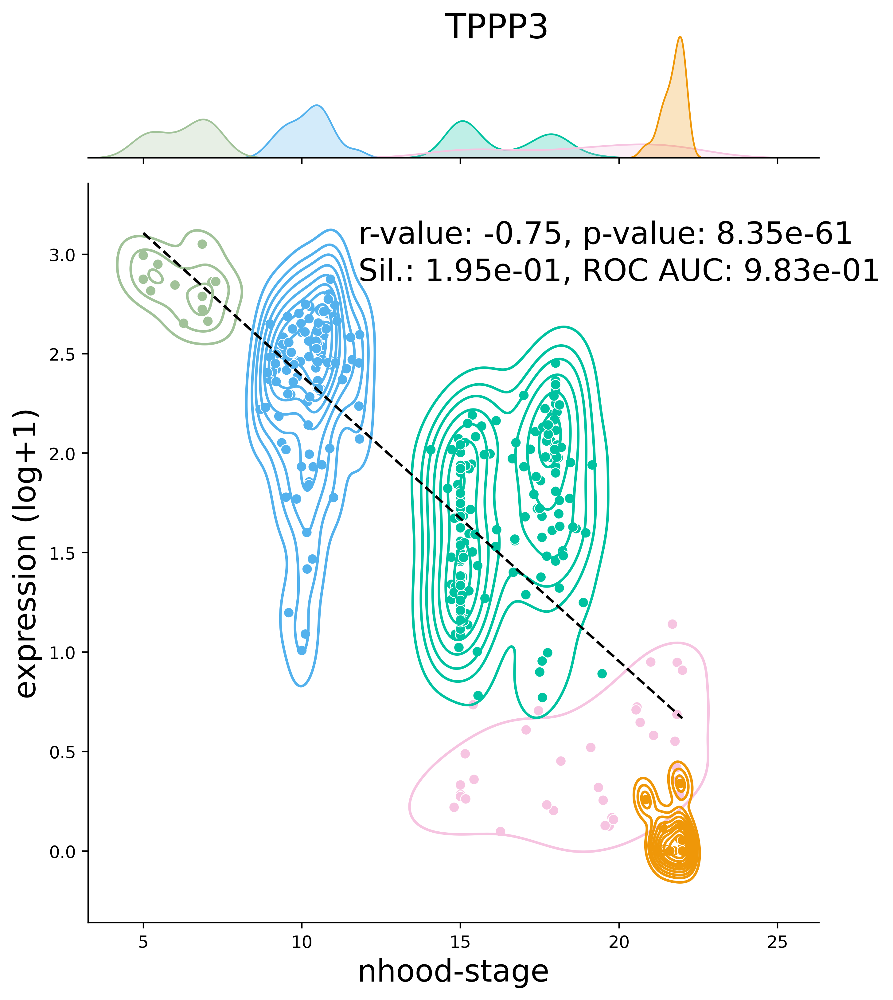

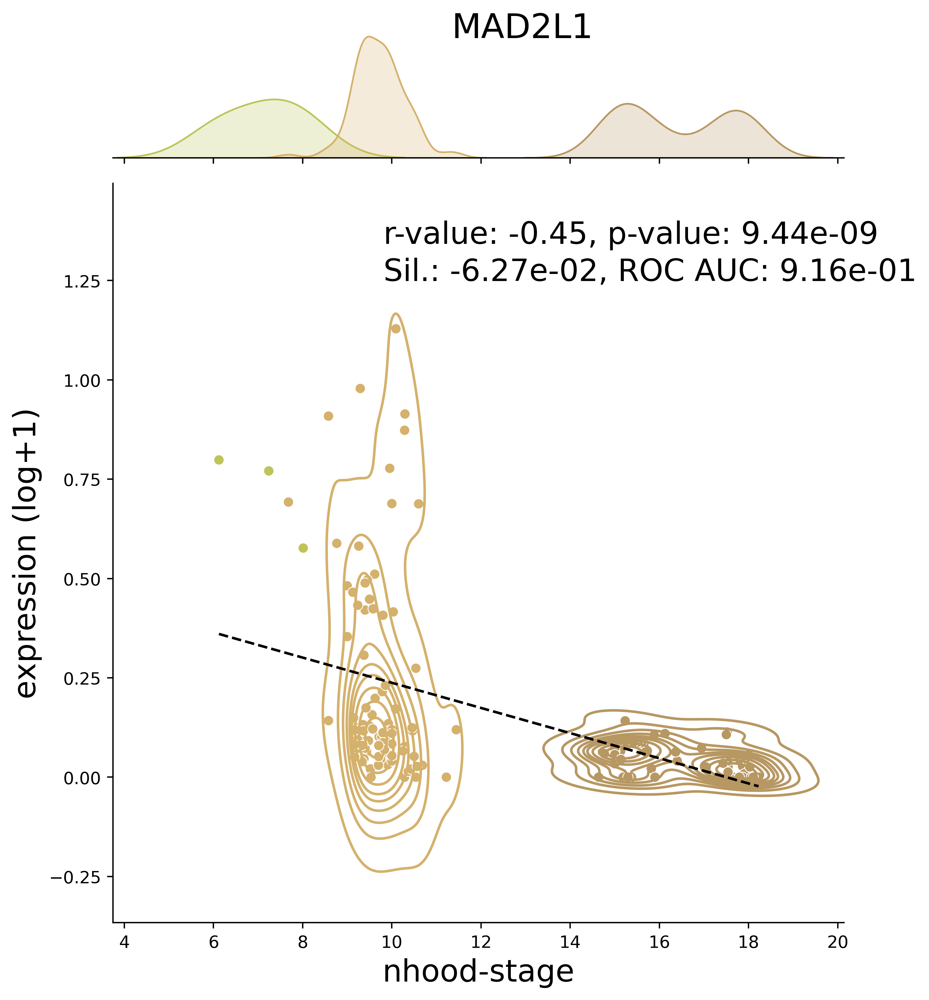

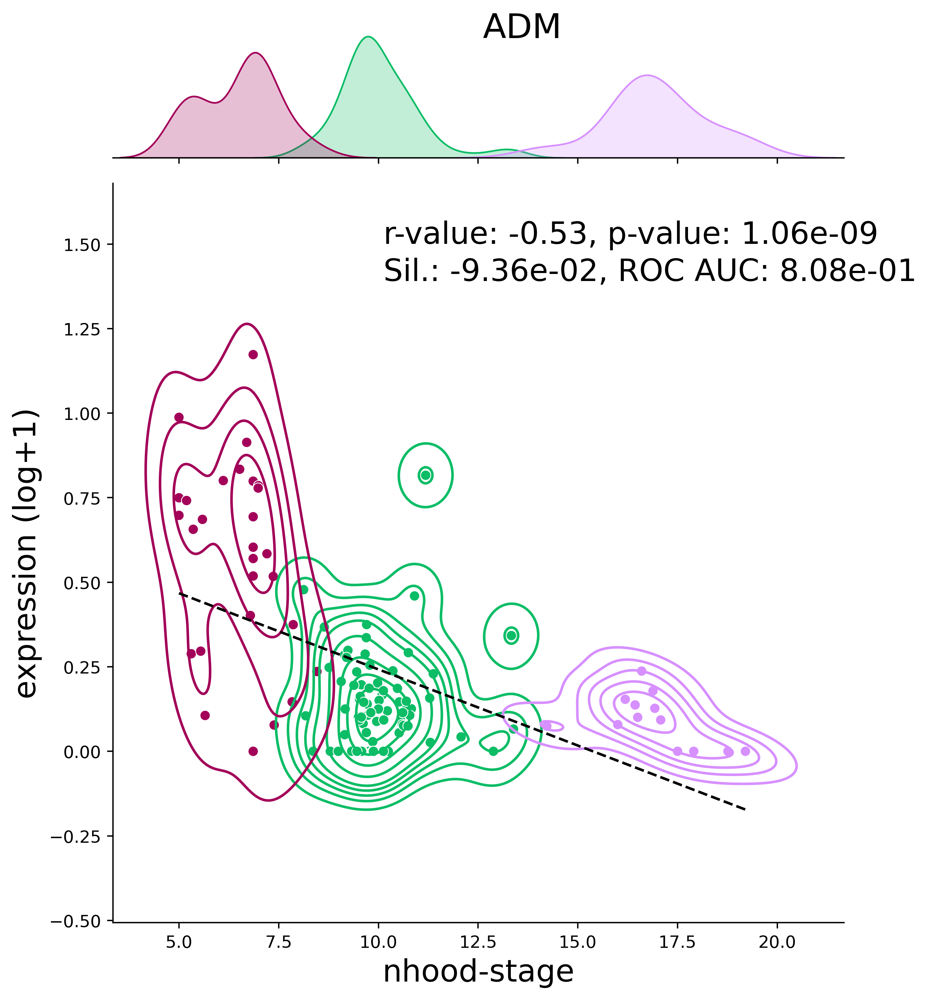

In [24]:
colors_dict = {'Mid tip': '#53b1ed',
 'Late tip': '#00c2a0',
 'AT2': '#f6c4e1',
 'AT1': '#ef9708',
 'Early tip': '#a1c299'}
plot_density_with_distribution(nhood_adata_tip.obs,'nhood_stage','nhood_TPPP3','nhood_annotation','TPPP3',colors_dict,save_as='lung_atlas_density_tip.pdf')



adata_stalk.obs['MAD2L1'] = adata_stalk.raw.to_adata()[:,'MAD2L1'].X.todense().flatten().tolist()[0]
milopy.utils.annotate_nhoods_continuous(adata_stalk, 'MAD2L1')
nhood_adata_stalk = adata_stalk.uns["nhood_adata"]

colors_dict = {'Early stalk': '#bec459',
 'Mid stalk': '#d4b16c',
 'Late stalk': '#b79762'}
plot_density_with_distribution(nhood_adata_stalk.obs,'nhood_stage','nhood_MAD2L1','nhood_annotation','MAD2L1',colors_dict,save_as='lung_atlas_density_stalk.pdf')



adata_airway.obs['ADM'] = adata_airway.raw.to_adata()[:,'ADM'].X.todense().flatten().tolist()[0]
milopy.utils.annotate_nhoods_continuous(adata_airway, 'ADM')
nhood_adata_airway = adata_airway.uns["nhood_adata"]

colors_dict = {'Mid airway progenitor': '#0cbd66',
 'Late airway progenitor': '#d790ff',
 'Early airway progenitor': '#a30059'}
plot_density_with_distribution(nhood_adata_airway.obs,'nhood_stage','nhood_ADM','nhood_annotation','ADM',colors_dict,save_as='lung_atlas_density_airway.pdf')

In [29]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import ttest_ind
from statannotations.Annotator import Annotator
import seaborn as sns
import scipy.stats as sci_stats

def label_plot_for_subcats(ax,gene):
    plt.title(gene, y=1.06)
    ax.set_ylabel("expression (log+1)")
    # ax.set_xlabel("cell type", labelpad=20)

def get_log_ax(label_plot_for_subcats,orient="v"):
    if orient == "v":
        figsize = (6, 6)
        set_scale = "set_yscale"
    else:
        figsize = (6, 6)
        set_scale = "set_xscale"
    fig, ax = plt.subplots(1, 1, figsize=figsize)
    fig.patch.set_alpha(1)
    getattr(ax, set_scale)("log")
    return ax    

def plot_box_with_pvalue(data,x,y,gene,desired_order,colors_dict,save_as=None):

    plotting_parameters = {
        'data':    data,
        'x':       x,
        'y':       y,
        # 'palette': subcat_palette[1:]
    }
    # Calculate p-values for each pair of consecutive time points
    p_values = []
    
    # Convert 'new_celltype' column to categorical with desired order
    data[x] = pd.Categorical(data[x], categories=desired_order, ordered=True)

    # Sort the DataFrame based on the categorical 'new_celltype' column
    data = data.sort_values(by=x)
    
    time_points = data[x].unique()
    for i in range(len(time_points) - 1):
        sample1 = data[data[x] == time_points[i]][y]
        sample2 = data[data[x] == time_points[i+1]][y]
        _, p = ttest_ind(sample1, sample2, equal_var=False)
        p_values.append(p)

    # Prepare pairs for annotator
    pairs = [(time_points[i], time_points[i+1]) for i in range(len(time_points) - 1)]

    # Transform each p-value to "p=" in scientific notation
    formatted_pvalues = [f'p={pvalue:.2e}' for pvalue in p_values]

    with sns.plotting_context('notebook', font_scale = 1.4):
        # Create new plot
        ax = get_log_ax(gene)
        
        # Plot with seaborn
        sns.boxplot(**plotting_parameters,palette=colors_dict)
        
        # Remove top and right border of the axis
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        sns.despine()
        
        
        # Add annotations
        annotator = Annotator(ax, pairs, **plotting_parameters)
        annotator.set_custom_annotations(formatted_pvalues)
        annotator.annotate()

        # Label and show
        label_plot_for_subcats(ax,gene)
       
    if save_as:
        plt.savefig('./figures/'+save_as, bbox_inches='tight')
    plt.show()


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Early tip vs. Mid tip: p=1.44e-14
Mid tip vs. Late tip: p=2.83e-113
Late tip vs. AT2: p=8.70e-116
AT2 vs. AT1: p=2.36e-30


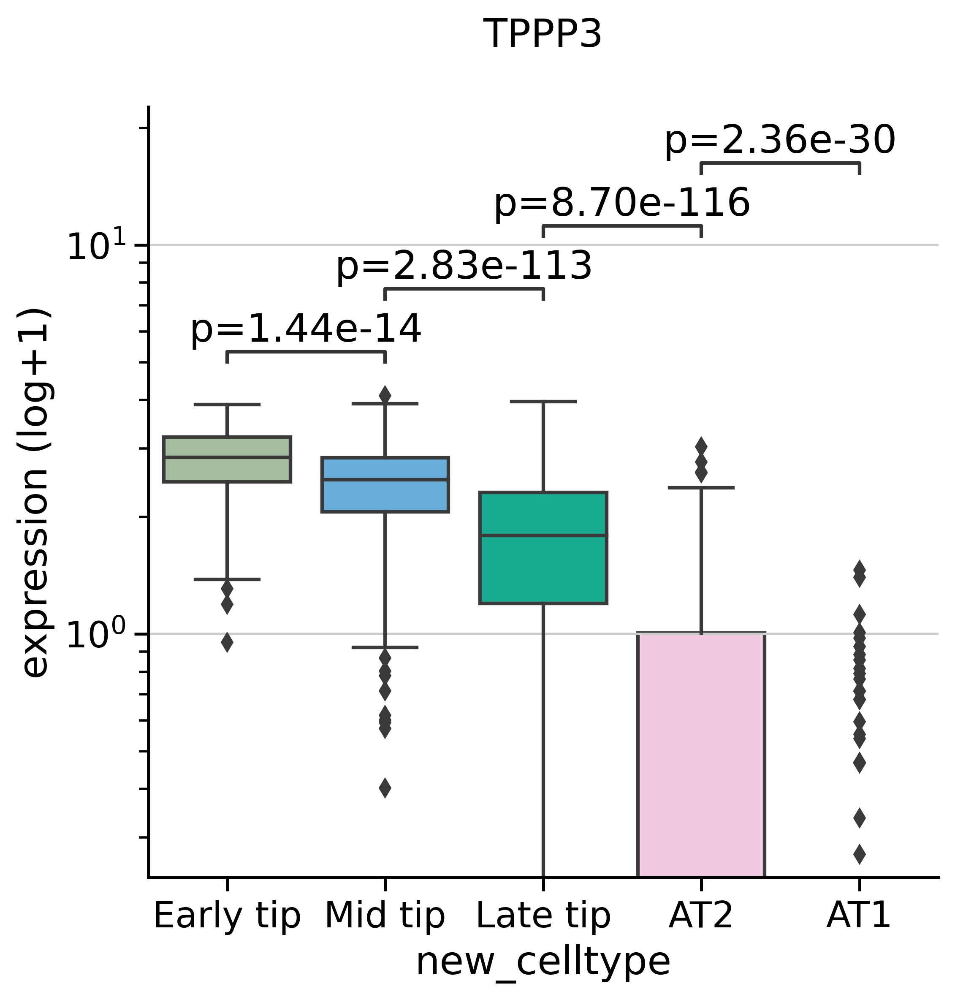

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Early stalk vs. Mid stalk: p=9.91e-09
Mid stalk vs. Late stalk: p=5.73e-33


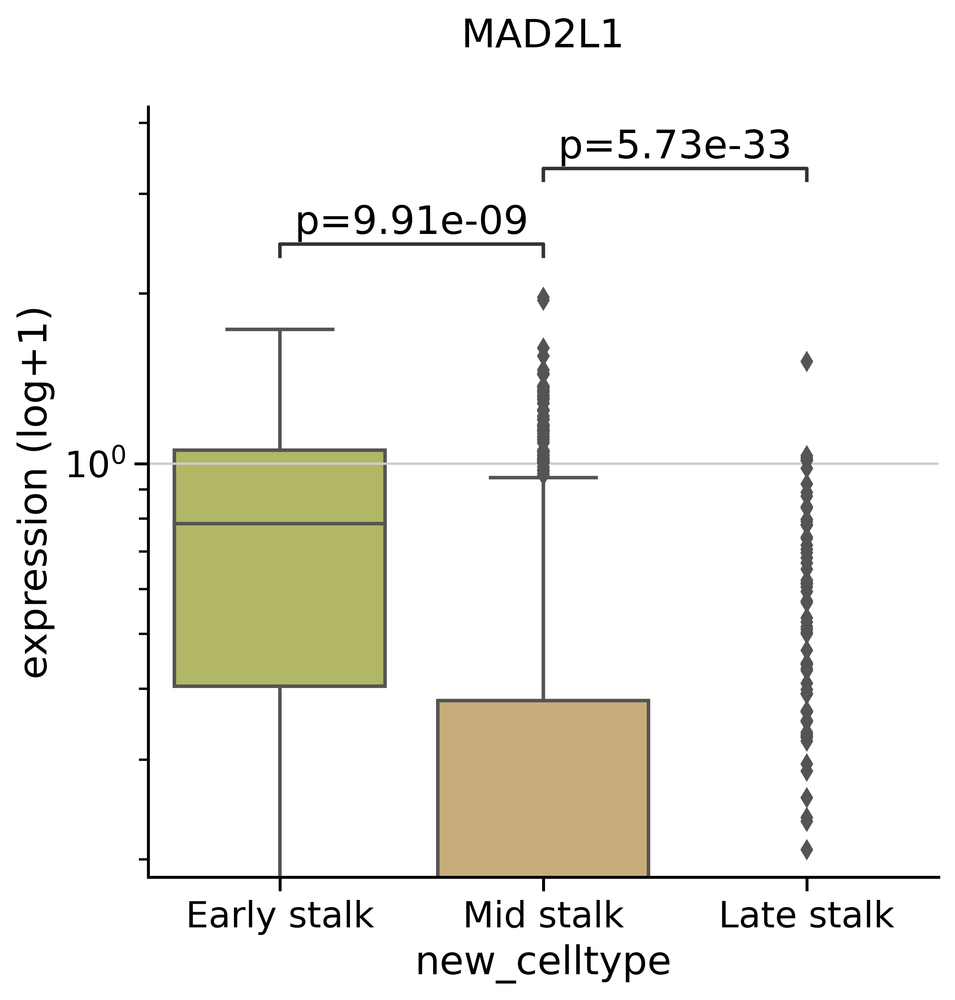

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Early airway progenitor vs. Mid airway progenitor: p=1.01e-24
Mid airway progenitor vs. Late airway progenitor: p=3.08e-04


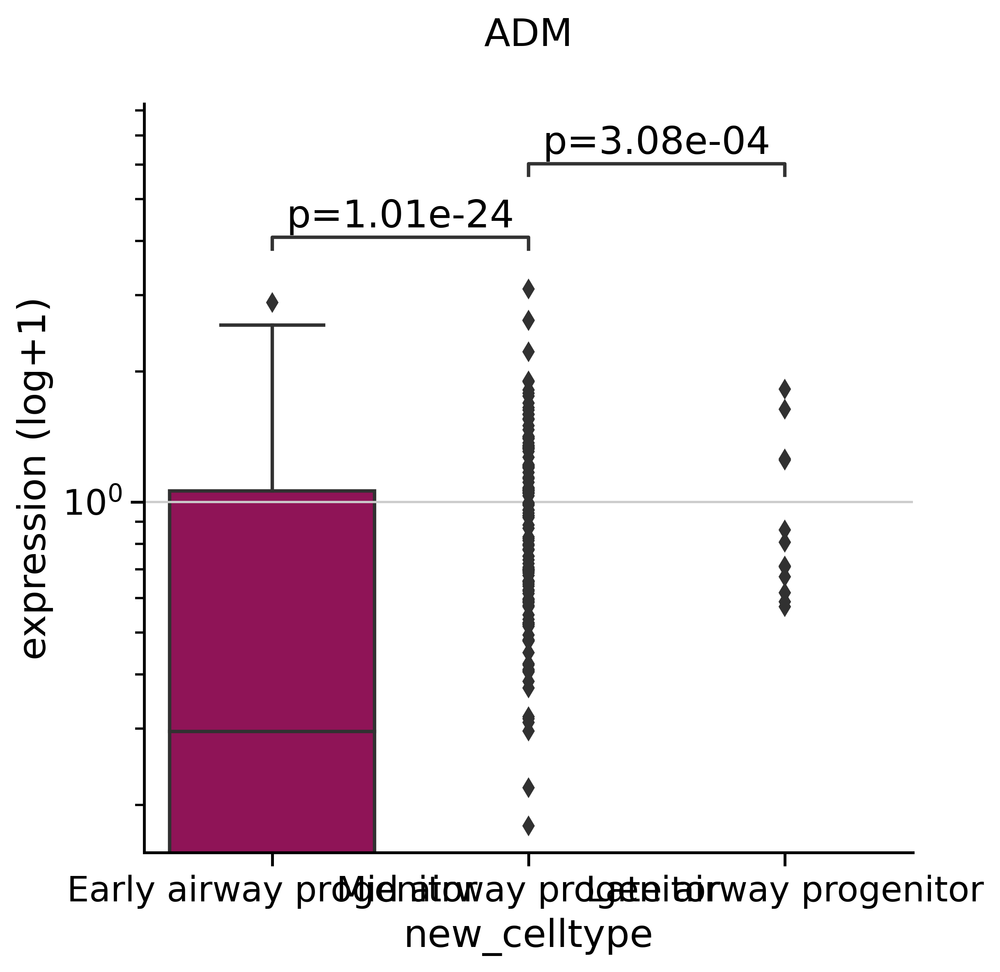

In [30]:
adata_tip.obs['TPPP3'] = adata_tip.raw.to_adata()[:,'TPPP3'].X.todense().flatten().tolist()[0]
adata_stalk.obs['MAD2L1'] = adata_stalk.raw.to_adata()[:,'MAD2L1'].X.todense().flatten().tolist()[0]
adata_airway.obs['ADM'] = adata_airway.raw.to_adata()[:,'ADM'].X.todense().flatten().tolist()[0]


# plot_box_with_pvalue(adata_tip.obs,'stage','TPPP3','TPPP3',[ 5.0,6.86,9.0,11.0,15.0,18.0,20.0,22.0])
colors_dict = {'Mid tip': '#53b1ed',
 'Late tip': '#00c2a0',
 'AT2': '#f6c4e1',
 'AT1': '#ef9708',
 'Early tip': '#a1c299'}
plot_box_with_pvalue(adata_tip.obs,'new_celltype','TPPP3','TPPP3',['Early tip','Mid tip','Late tip', 'AT2','AT1'],colors_dict,save_as='lung_atlas_exp_bar_tip.pdf')



adata_stalk.obs['MAD2L1'] = adata_stalk.raw.to_adata()[:,'MAD2L1'].X.todense().flatten().tolist()[0]
colors_dict = {'Early stalk': '#bec459',
 'Mid stalk': '#d4b16c',
 'Late stalk': '#b79762'}
plot_box_with_pvalue(adata_stalk.obs,'new_celltype','MAD2L1','MAD2L1',['Early stalk','Mid stalk','Late stalk'],colors_dict,save_as='lung_atlas_exp_bar_stalk.pdf')



adata_airway.obs['ADM'] = adata_airway.raw.to_adata()[:,'ADM'].X.todense().flatten().tolist()[0]
colors_dict = {'Mid airway progenitor': '#0cbd66',
 'Late airway progenitor': '#d790ff',
 'Early airway progenitor': '#a30059'}
plot_box_with_pvalue(adata_airway.obs,'new_celltype','ADM','ADM',['Early airway progenitor','Mid airway progenitor','Late airway progenitor'],colors_dict,save_as='lung_atlas_exp_bar_airway.pdf')




## DE genes

In [105]:
data_dir = '/lustre/scratch126/cellgen/team292/ha10/data/Fetal_Lung/'
nhood_adata_tip = sc.read(data_dir+'nhood_adata_tip.h5ad')
nhood_adata_stalk = sc.read(data_dir+'nhood_adata_stalk.h5ad')
nhood_adata_airway = sc.read(data_dir+'nhood_adata_airway.h5ad')

In [72]:
adata_tmp = sc.read(data_dir+'adata_fetal_lung_epithelial_30_0_stage_study_nocg_nocc.h5ad')

adata_tip = adata_tmp[adata_tmp.obs.new_celltype.isin(['AT1','AT2','Early tip','Mid tip','Late tip'])]
adata_stalk = adata_tmp[adata_tmp.obs.new_celltype.isin(['Early stalk','Mid stalk','Late stalk'])]
adata_airway = adata_tmp[adata_tmp.obs.new_celltype.isin(['Early airway progenitor','Mid airway progenitor','Late airway progenitor'])]

In [73]:
nhood_adata_tip

AnnData object with n_obs × n_vars = 333 × 3
    obs: 'index_cell', 'kth_distance', 'Nhood_size', 'nhood_stage', 'nhood_annotation', 'nhood_annotation_frac', 'nhood_HMGA1', 'nhood_RAN', 'nhood_STMN1', 'nhood_UCHL1', 'nhood_APOA1', 'nhood_HSPA1A', 'nhood_HSPA1B', 'nhood_HSP90AA1', 'nhood_XIST', 'nhood_TUBB2B', 'nhood_VIM', 'nhood_GSTM1', 'nhood_FSCN1', 'nhood_EEF1G', 'nhood_HINT1', 'nhood_IGFBP2', 'nhood_TPPP3', 'nhood_COL9A3', 'nhood_RPL41', 'nhood_SNHG7', 'nhood_ID3', 'nhood_ID1', 'nhood_CTSH', 'nhood_CD36', 'nhood_CEBPD', 'nhood_SFTPC', 'nhood_ZFP36', 'nhood_FOSB', 'nhood_SFTPB', 'nhood_TMSB4X', 'nhood_FAM41C', 'nhood_WIF1', 'nhood_S100A10', 'nhood_IFITM3', 'nhood_MYL9', 'nhood_CLIC3'
    uns: 'sample_col', 'nhood', 'annotation_labels', 'annotation_obs'
    obsm: 'X_milo_graph', 'frac_annotation'
    obsp: 'nhood_connectivities'

In [74]:
tip_genes = ['nhood_HMGA1', 'nhood_RAN', 'nhood_STMN1', 'nhood_UCHL1', 
 'nhood_APOA1', 'nhood_HSPA1A', 'nhood_HSPA1B', 'nhood_HSP90AA1', 'nhood_XIST', 'nhood_TUBB2B', 
 'nhood_VIM', 'nhood_GSTM1', 'nhood_FSCN1', 'nhood_EEF1G', 'nhood_HINT1', 'nhood_IGFBP2', 'nhood_TPPP3', 
 'nhood_COL9A3', 'nhood_RPL41', 'nhood_SNHG7', 'nhood_ID3', 'nhood_ID1', 'nhood_CTSH', 'nhood_CD36', 'nhood_CEBPD',
 'nhood_SFTPC', 'nhood_ZFP36', 'nhood_FOSB', 'nhood_SFTPB', 'nhood_TMSB4X', 'nhood_FAM41C', 'nhood_WIF1', 'nhood_S100A10', 'nhood_IFITM3', 'nhood_MYL9', 'nhood_CLIC3']
tip_adata_DE_genes = sc.AnnData(nhood_adata_tip.obs[tip_genes])
tip_adata_DE_genes.shape

(333, 36)

In [75]:
tip_adata_DE_genes.var_names = [x[6:] for x in tip_genes]
tip_adata_DE_genes.obs_names = nhood_adata_tip.obs_names

tip_adata_DE_genes.obs = nhood_adata_tip.obs

In [76]:
set(adata_tmp.obs['new_celltype'])

{'AT1',
 'AT2',
 'Ciliated',
 'Club',
 'Deuterosomal',
 'Early airway progenitor',
 'Early stalk',
 'Early tip',
 'GHRL+ NE precursor',
 'GHRL+ neuroendocrine',
 'Interm neuroendocrine',
 'Late airway progenitor',
 'Late basal',
 'Late stalk',
 'Late tip',
 'MUC16+ ciliated',
 'MUC5AC+ ASCL1+ progenitor',
 'Mid airway progenitor',
 'Mid basal',
 'Mid stalk',
 'Mid tip',
 'Proximal basal',
 'Proximal secretory 1',
 'Proximal secretory 2',
 'Proximal secretory 3',
 'Proximal secretory progenitors',
 'Pulmonary NE precursor',
 'Pulmonary neuroendocrine',
 'SMG',
 'SMG basal',
 'Squamous'}

Global seed set to 0


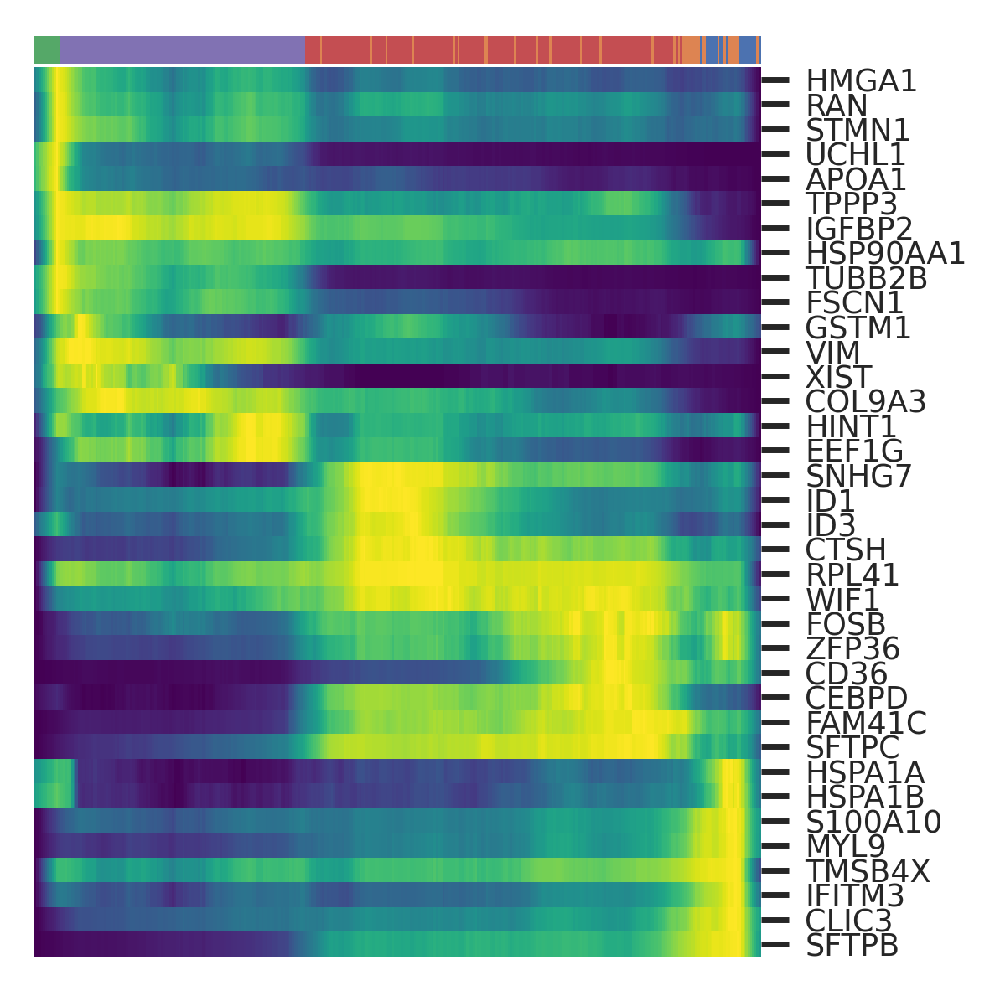

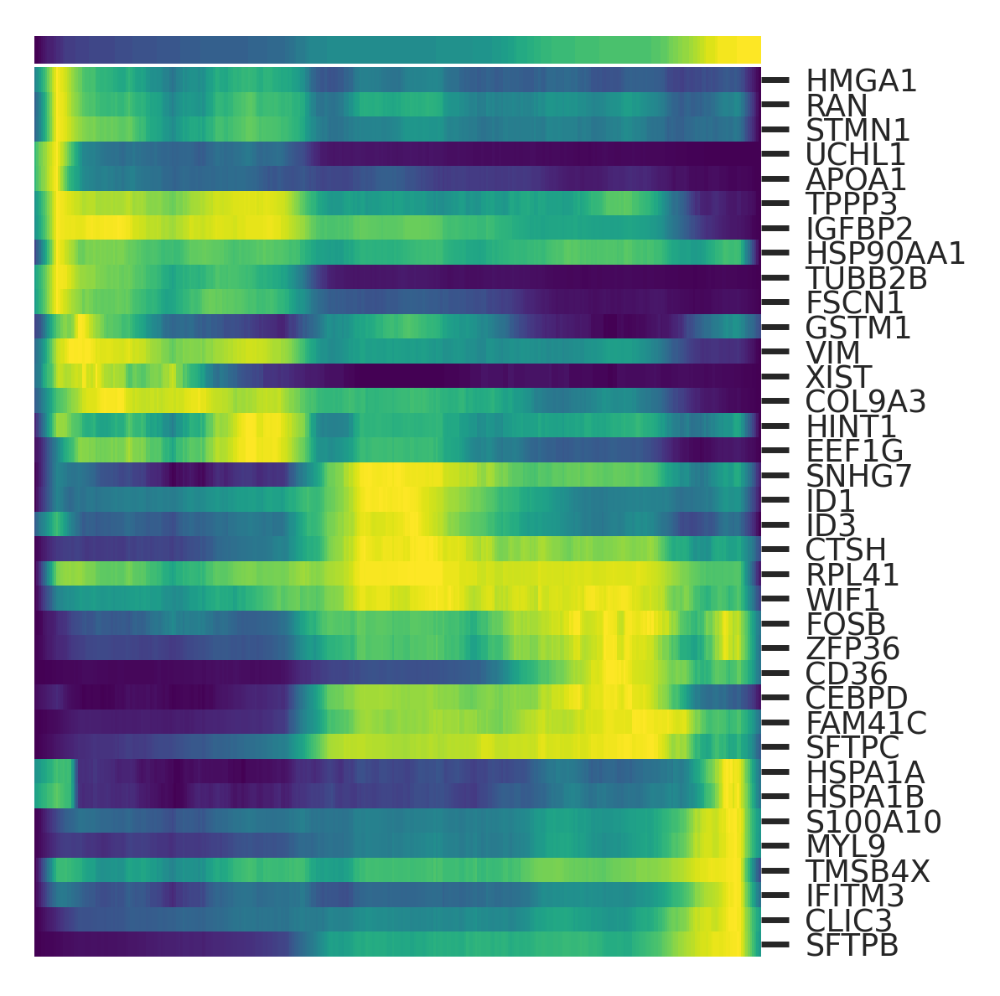

In [77]:
import scvelo as scv
import seaborn as sns
sns.set_style("whitegrid", {'axes.grid' : False})
sns.set(font_scale=0.6)
sns.color_palette("magma")
scv.pl.heatmap(tip_adata_DE_genes, var_names=tip_adata_DE_genes.var_names, sortby='nhood_stage', col_color='nhood_annotation', n_convolve=20, yticklabels=1,figsize=(3, 3))
scv.pl.heatmap(tip_adata_DE_genes, var_names=tip_adata_DE_genes.var_names, sortby='nhood_stage', col_color='nhood_stage', n_convolve=20, yticklabels=1,figsize=(3, 3))

# import scFates as scf
# scf.pl.trends(nhood_adata_tip,features=tip_genes,basis="milo_graph")

saving figure to file ./figures/scvelo_heatmap_lung_atlas_tip_DE_genes_stage.pdf


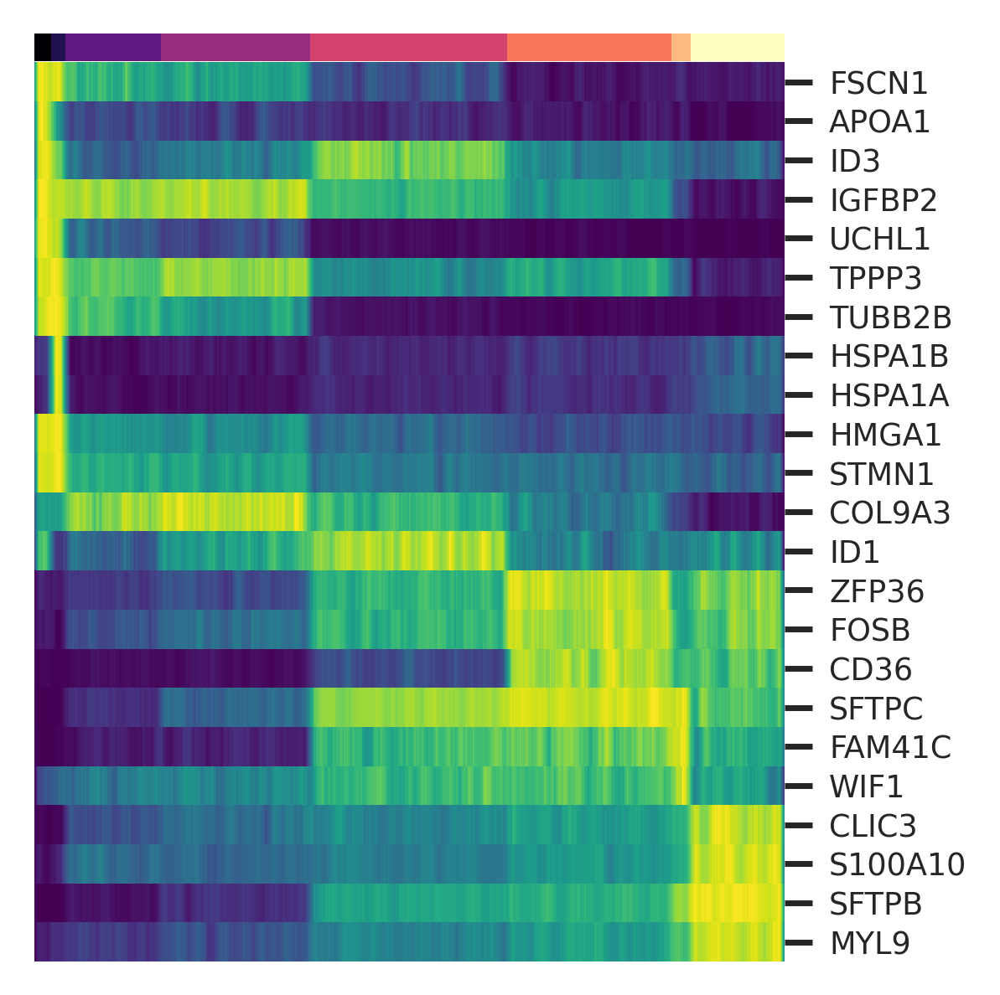

saving figure to file ./figures/scvelo_heatmap_lung_atlas_tip_DE_genes_celltype.pdf


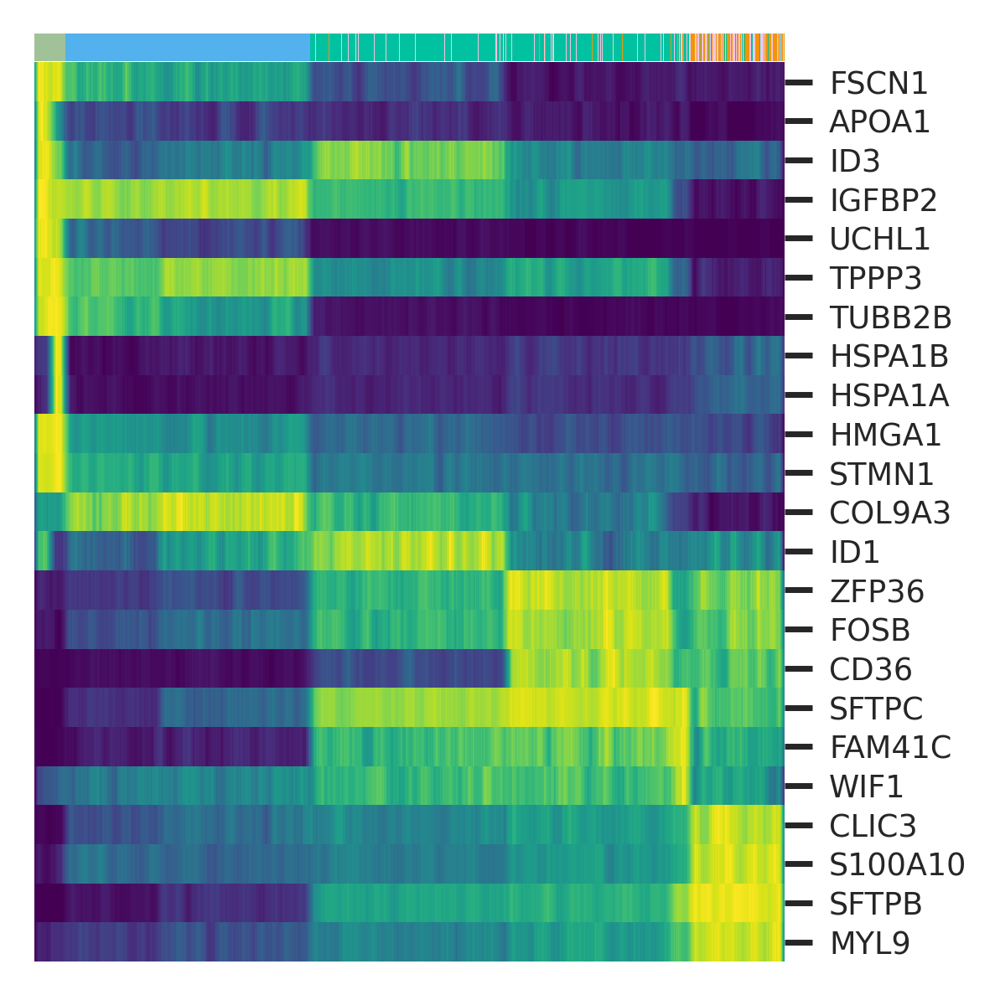

In [80]:
# sns.color_palette("magma")
scv.pl.heatmap(adata_tip, var_names=tip_adata_DE_genes.var_names, sortby='stage', col_color='stage', n_convolve=50, yticklabels=1,figsize=(3, 3),palette="magma",save='lung_atlas_tip_DE_genes_stage.pdf')
scv.pl.heatmap(adata_tip, var_names=tip_adata_DE_genes.var_names, sortby='stage', col_color='new_celltype', n_convolve=50, yticklabels=1,figsize=(3, 3),save='lung_atlas_tip_DE_genes_celltype.pdf')


In [16]:
adata_tip.obs['stage'] = adata_tip.obs['stage'].astype(str)

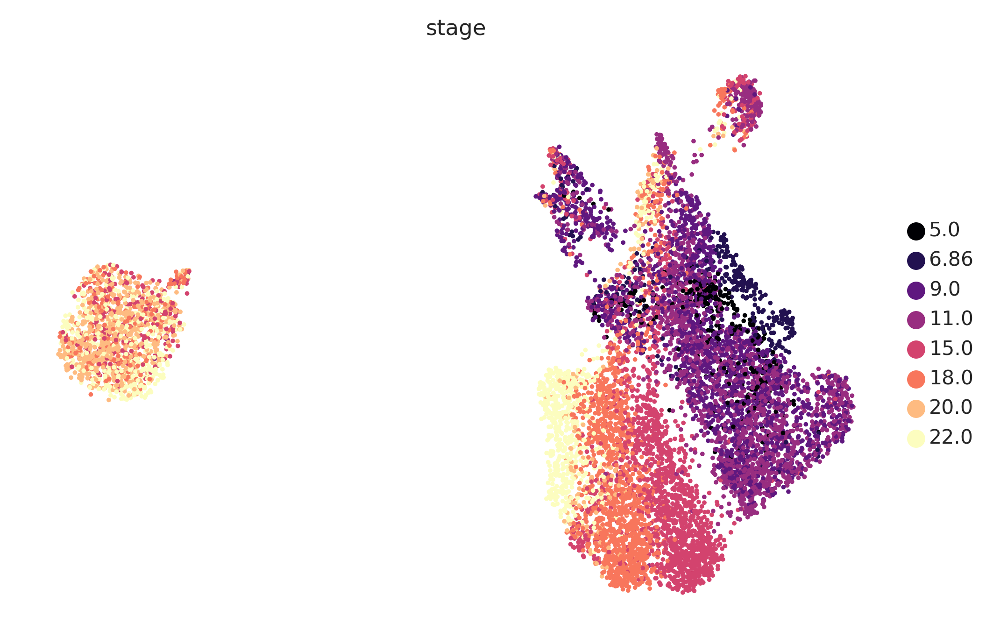

In [17]:
adata_tmp.obs['stage'] = adata_tmp.obs['stage'].astype(str)
sc.pl.umap(adata_tmp,color='stage',palette="magma")